In [1]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
import scipy.ndimage
import nibabel as nib
from scipy import ndimage
from scipy.ndimage import gaussian_filter
import numpy as np
from skimage.transform import radon
import matplotlib.pyplot as plt

X = []
# Define a function to extract ROIs around microbleed locations
def extract_roi(swi_data, coordinates, roi_size):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        # Ensure the ROI stays within the image bounds
        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)
        
        # Extract the ROI from the image data
        roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(roi)
    return rois

# Define a function to compute Hessian matrix eigenvalues
def compute_hessian_eigenvalues(roi):
    # Apply Gaussian filter to the ROI for smoothing
    smoothed_roi = gaussian_filter(roi, sigma=1)
    
    # Compute gradients along x, y, and z directions using Sobel filters
    gradient_x = ndimage.sobel(smoothed_roi, axis=0)
    gradient_y = ndimage.sobel(smoothed_roi, axis=1)
    gradient_z = ndimage.sobel(smoothed_roi, axis=2)
    
    # Compute second derivatives along x, y, and z directions
    dxx = ndimage.sobel(gradient_x, axis=0)
    dyy = ndimage.sobel(gradient_y, axis=1)
    dzz = ndimage.sobel(gradient_z, axis=2)
    dxy = ndimage.sobel(gradient_x, axis=1)
    dxz = ndimage.sobel(gradient_x, axis=2)
    dyz = ndimage.sobel(gradient_y, axis=2)
    
    # Construct the Hessian matrix
    Hessian_matrix = np.array([
        [dxx.mean(), dxy.mean(), dxz.mean()],
        [dxy.mean(), dyy.mean(), dyz.mean()],
        [dxz.mean(), dyz.mean(), dzz.mean()]
    ])
    
    # Compute eigenvalues and eigenvectors of the Hessian matrix
    eigenvalues, eigenvectors = np.linalg.eig(Hessian_matrix)
    
    return eigenvalues, eigenvectors

# Define a function to compute Hessian shape features
def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        # If the number of eigenvalues is not 3, return default values or handle the case accordingly
        print("Invalid number of eigenvalues for computing features")
        return 0, 0, 0  # Return default values or handle differently if needed
    
    # Sphericalness feature
    f_sphere = abs(eigenvalues[0]) / np.sqrt(abs(eigenvalues[1] * eigenvalues[2]))
    
    # Largest cross-section feature
    f_lc = abs(eigenvalues[1]) / abs(eigenvalues[2])
    
    # Fractional anisotropy feature
    f_fa = np.sqrt(0.5) * np.sqrt((eigenvalues[0] - eigenvalues[1])**2 + 
                                  (eigenvalues[1] - eigenvalues[2])**2 + 
                                  (eigenvalues[0] - eigenvalues[2])**2) / np.sqrt((eigenvalues[0]**2 + eigenvalues[1]**2 + eigenvalues[2]**2))
    
    return f_sphere, f_lc, f_fa


def compute_radon_features(microbleed_rois, angles):
    sinograms = []
    for roi_slice in microbleed_rois:
        rotated_slices = [scipy.ndimage.rotate(roi_slice, angle, reshape=False) for angle in angles]
        sinogram = np.stack(rotated_slices, axis=-1)
        sinograms.append(sinogram)
    return np.stack(sinograms, axis=0)

def compute_radon_shape_features(radon_features):
    # Extract the dimensions
    num_coordinates, roi_size_x, roi_size_y, roi_size_z, num_angles = radon_features.shape
    
    # Initialize arrays to store results
    fmean = np.zeros((num_coordinates, num_angles))
    fstd = np.zeros((num_coordinates, num_angles))
    
    # Compute Radon shape features
    for coord in range(num_coordinates):
        for angle in range(num_angles):
            # Mean profile
            fmean[coord, angle] = np.mean(radon_features[coord, :, :, :, angle])
            
            # Standard deviation profile
            fstd[coord, angle] = np.std(radon_features[coord, :, :, :, angle])

            
    return fmean, fstd

# Load the Excel file containing microbleed coordinates
excel_file = 'sCmb_filteredV5_output-small.xlsx'  # Replace with your Excel file path
df = pd.read_excel(excel_file)

# Path to the folder containing the NIFTI images
folder_path = 'chunk'  # Replace 'path_to_rCMB_folder' with your folder path
combined_features_list = []
# Iterate through rows to load NIFTI files and extract microbleed features
for index, row in df.iterrows():
    nifti_filename = row['NIFTI']  # Assuming 'NIFTI' is the column name containing the NIFTI file names
    nifti_path = os.path.join(folder_path, nifti_filename)

    # Check if the NIFTI file exists in the folder
    if os.path.exists(nifti_path):
        swi_img = nib.load(nifti_path)
        swi_data = swi_img.get_fdata()

        microbleed_coordinates = []
        for i in range(1, len(row), 3):
                try:
                    if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                        x = int(row.iloc[i])
                        y = int(row.iloc[i+1])
                        z = int(row.iloc[i+2])
                        microbleed_coordinates.append((x, y, z))
                except (ValueError, TypeError):
                    pass
            # Define the size of the ROI around each microbleed
        roi_size = 10 # Adjust this according to your desired size

        # Extract ROIs around microbleed locations
        microbleed_rois = extract_roi(swi_data, microbleed_coordinates, roi_size)

        # Compute Radon features for each ROI
        angles = np.arange(0, 180, 15)
        radon_features_microbleed = compute_radon_features(microbleed_rois, angles)

        # Compute Radon shape features for each microbleed
        fmean_microbleed_radon, fstd_microbleed_radon = compute_radon_shape_features(radon_features_microbleed)

        # Compute Hessian matrix and eigenvalues for each ROI
        eigenvalues_list = []
        for roi in microbleed_rois:
            eigenvalues = compute_hessian_eigenvalues(roi)
            eigenvalues_list.append(eigenvalues)

        # Compute Hessian shape features for each microbleed
        hessian_shape_features_microbleed = []
        for i, eigenvals_tuple in enumerate(eigenvalues_list):
            eigenvals = eigenvals_tuple[0]  # Unpack the nested structure
            if len(eigenvals) != 3:
                # Print the invalid eigenvalues and their count for inspection
                print(f"Invalid eigenvalues at index {i+1}: {eigenvals} (Count: {len(eigenvals)})")
                continue

            f_sphere, f_lc, f_fa = compute_hessian_shape_features(eigenvals)
            hessian_shape_features_microbleed.append(np.array([f_sphere, f_lc, f_fa]))

        # Append Radon features (flattened) with Hessian features 
        for coord, fmean_values, fstd_values, hessian_features in zip(
                microbleed_coordinates, fmean_microbleed_radon, fstd_microbleed_radon, hessian_shape_features_microbleed
        ):
            flattened_radon_values = np.concatenate((fmean_values.flatten(), fstd_values.flatten()))
            combined_features = np.concatenate((np.array(flattened_radon_values), np.array(hessian_features)))
            #print(hessian_features)
            #print(flattened_radon_values)
            #print(combined_features)
            X.append(combined_features)
            #print(X)
          
            #print()
# Convert the list of microbleed features to a NumPy array
X1 =  np.array(X)
print(X1.shape)
print(X1)

(10, 27)
[[ 0.13391498  0.10799398  0.10266042  0.10286659  0.10283318  0.10794951
   0.13391498  0.10799398  0.10266042  0.10286659  0.10283318  0.10794951
   0.03664741  0.06345182  0.06590776  0.06588446  0.06607998  0.06341813
   0.03664741  0.06345182  0.06590776  0.06588446  0.06607998  0.06341813
   3.74480836  0.04710648  1.22233234]
 [ 0.08586331  0.07031131  0.06721322  0.06725821  0.06724699  0.07030214
   0.08586331  0.07031131  0.06721322  0.06725821  0.06724699  0.07030214
   0.07283293  0.07693663  0.07711339  0.07726693  0.07724982  0.0769703
   0.07283293  0.07693663  0.07711339  0.07726693  0.07724982  0.0769703
   2.80602588  0.33606045  1.17333504]
 [ 0.13066166  0.10415073  0.09907412  0.09880637  0.09883859  0.10418066
   0.13066166  0.10415073  0.09907412  0.09880637  0.09883859  0.10418066
   0.05023162  0.06978503  0.0721661   0.07216394  0.07167716  0.06980354
   0.05023162  0.06978503  0.0721661   0.07216394  0.07167716  0.06980354
   2.68795972  0.09012727  

In [27]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
from scipy import ndimage
from scipy.ndimage import gaussian_filter
from skimage.transform import radon
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Extract cubic ROIs from 3D image
def extract_roi(swi_data, coordinates, roi_size):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)
        roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(roi)
    return rois

# Compute Hessian features
def compute_hessian_eigenvalues(roi):
    smoothed_roi = gaussian_filter(roi, sigma=1)
    grad_x = ndimage.sobel(smoothed_roi, axis=0)
    grad_y = ndimage.sobel(smoothed_roi, axis=1)
    grad_z = ndimage.sobel(smoothed_roi, axis=2)
    dxx = ndimage.sobel(grad_x, axis=0)
    dyy = ndimage.sobel(grad_y, axis=1)
    dzz = ndimage.sobel(grad_z, axis=2)
    dxy = ndimage.sobel(grad_x, axis=1)
    dxz = ndimage.sobel(grad_x, axis=2)
    dyz = ndimage.sobel(grad_y, axis=2)
    H = np.array([
        [dxx.mean(), dxy.mean(), dxz.mean()],
        [dxy.mean(), dyy.mean(), dyz.mean()],
        [dxz.mean(), dyz.mean(), dzz.mean()]
    ])
    eigenvalues, _ = np.linalg.eig(H)
    return eigenvalues

def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        return 0, 0, 0
    f_sphere = abs(eigenvalues[0]) / np.sqrt(abs(eigenvalues[1] * eigenvalues[2]) + 1e-6)
    f_lc = abs(eigenvalues[1]) / (abs(eigenvalues[2]) + 1e-6)
    f_fa = np.sqrt(0.5) * np.sqrt(
        (eigenvalues[0] - eigenvalues[1])**2 +
        (eigenvalues[1] - eigenvalues[2])**2 +
        (eigenvalues[0] - eigenvalues[2])**2
    ) / np.sqrt(np.sum(np.square(eigenvalues)) + 1e-6)
    return f_sphere, f_lc, f_fa

# Compute Radon shape features from 2D projections
def compute_radon_shape_features(roi, theta=np.arange(0, 180, 15)):
    projections = {
        "axial": np.mean(roi, axis=2),
        "coronal": np.mean(roi, axis=1),
        "sagittal": np.mean(roi, axis=0)
    }

    features = []
    for key in projections:
        proj = projections[key]
        radon_img = radon(proj, theta=theta, circle=False)
        features.extend([np.mean(radon_img), np.std(radon_img)])
    return features

# ===== MAIN PROCESS =====

# Load coordinates
excel_file = 'scmb_filteredV5_output.xlsx'
df = pd.read_excel(excel_file)
folder_path = 'Scmb-non'

X = []
for index, row in df.iterrows():
    nifti_filename = row['NIFTI']
    nifti_path = os.path.join(folder_path, nifti_filename)

    if not os.path.exists(nifti_path):
        continue

    img = nib.load(nifti_path)
    data = img.get_fdata()

    # Read coordinates from Excel row
    coords = []
    for i in range(1, len(row), 3):
        try:
            if pd.notnull(row.iloc[i:i+3]).all():
                coords.append((int(row.iloc[i]), int(row.iloc[i+1]), int(row.iloc[i+2])))
        except:
            continue

    rois = extract_roi(data, coords, roi_size=10)
    for roi in rois:
        if roi.shape != (10, 10, 10):  # Ensure shape match
            continue

        # Compute Hessian features
        eigenvals = compute_hessian_eigenvalues(roi)
        h_features = compute_hessian_shape_features(eigenvals)

        # Compute Radon shape features
        r_features = compute_radon_shape_features(roi)

        combined = list(h_features) + list(r_features)
        X.append(combined)

# Convert to DataFrame
columns = ['f_sphere', 'f_lc', 'f_fa', 'radon_axial_mean', 'radon_axial_std',
           'radon_coronal_mean', 'radon_coronal_std', 'radon_sagittal_mean', 'radon_sagittal_std']

features_df = pd.DataFrame(combined_features, columns=columns)
features_df.to_csv("microbleed_hessian_radon_features.csv", index=False)
print("Feature extraction completed and saved.")

X1 =  np.array(X)
print(X1.shape)

Feature extraction completed and saved.
(3130, 9)


In [28]:

# Determine the number of microbleeds in X
num_microbleeds = X1.shape[0]

# Set the labels for microbleeds as 1
Y1 = np.ones(num_microbleeds)

# Display the shape of the label array
print(f"Shape of Y0 (labels): {Y1.shape}")

# Display a few labels to confirm
print(Y1)

Shape of Y0 (labels): (3130,)
[1. 1. 1. ... 1. 1. 1.]


In [ ]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
import scipy.ndimage
import nibabel as nib
from scipy import ndimage
from scipy.ndimage import gaussian_filter
import numpy as np
from skimage.transform import radon
import matplotlib.pyplot as plt

X = []
# Define a function to extract ROIs around microbleed locations
def extract_roi(swi_data, coordinates, roi_size):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        # Ensure the ROI stays within the image bounds
        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)
        
        # Extract the ROI from the image data
        roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(roi)
    return rois


# Define a function to compute Hessian matrix eigenvalues
def compute_hessian_eigenvalues(roi):
    # Apply Gaussian filter to the ROI for smoothing
    smoothed_roi = gaussian_filter(roi, sigma=1)
    
    # Compute gradients along x, y, and z directions using Sobel filters
    gradient_x = ndimage.sobel(smoothed_roi, axis=0)
    gradient_y = ndimage.sobel(smoothed_roi, axis=1)
    gradient_z = ndimage.sobel(smoothed_roi, axis=2)
    
    # Compute second derivatives along x, y, and z directions
    dxx = ndimage.sobel(gradient_x, axis=0)
    dyy = ndimage.sobel(gradient_y, axis=1)
    dzz = ndimage.sobel(gradient_z, axis=2)
    dxy = ndimage.sobel(gradient_x, axis=1)
    dxz = ndimage.sobel(gradient_x, axis=2)
    dyz = ndimage.sobel(gradient_y, axis=2)
    
    # Construct the Hessian matrix
    Hessian_matrix = np.array([
        [dxx.mean(), dxy.mean(), dxz.mean()],
        [dxy.mean(), dyy.mean(), dyz.mean()],
        [dxz.mean(), dyz.mean(), dzz.mean()]
    ])
    
    # Compute eigenvalues and eigenvectors of the Hessian matrix
    eigenvalues, eigenvectors = np.linalg.eig(Hessian_matrix)
    
    return eigenvalues, eigenvectors

# Define a function to compute Hessian shape features
def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        # If the number of eigenvalues is not 3, return default values or handle the case accordingly
        print("Invalid number of eigenvalues for computing features")
        return 0, 0, 0  # Return default values or handle differently if needed
    
    # Sphericalness feature
    f_sphere = abs(eigenvalues[0]) / np.sqrt(abs(eigenvalues[1] * eigenvalues[2]))
    
    # Largest cross-section feature
    f_lc = abs(eigenvalues[1]) / abs(eigenvalues[2])
    
    # Fractional anisotropy feature
    f_fa = np.sqrt(0.5) * np.sqrt((eigenvalues[0] - eigenvalues[1])**2 + 
                                  (eigenvalues[1] - eigenvalues[2])**2 + 
                                  (eigenvalues[0] - eigenvalues[2])**2) / np.sqrt((eigenvalues[0]**2 + eigenvalues[1]**2 + eigenvalues[2]**2))
    
    return f_sphere, f_lc, f_fa



def compute_radon_features(microbleed_rois, angles):
    sinograms = []
    for roi_slice in microbleed_rois:
        rotated_slices = [scipy.ndimage.rotate(roi_slice, angle, reshape=False) for angle in angles]
        sinogram = np.stack(rotated_slices, axis=-1)
        
        # Check if the current sinogram has the same shape as the previous sinograms
        if sinograms and sinogram.shape != sinograms[0].shape:
            #print("Skipping ROI due to different shape:", sinogram.shape)
            continue
        
        sinograms.append(sinogram)
        
    return np.stack(sinograms, axis=0)


def compute_radon_shape_features(radon_features):
    # Extract the dimensions
    num_coordinates, roi_size_x, roi_size_y, roi_size_z, num_angles = radon_features.shape
    
    # Initialize arrays to store results
    fmean = np.zeros((num_coordinates, num_angles))
    fstd = np.zeros((num_coordinates, num_angles))
    
    # Compute Radon shape features
    for coord in range(num_coordinates):
        for angle in range(num_angles):
            # Mean profile
            fmean[coord, angle] = np.mean(radon_features[coord, :, :, :, angle])
            
            # Standard deviation profile
            fstd[coord, angle] = np.std(radon_features[coord, :, :, :, angle])

            #print(fmean)
            #print(fstd)

            
    return fmean, fstd

# Load the Excel file containing microbleed coordinates
excel_file = 'scmb_filteredV6_output.xlsx'  # Replace with your Excel file path
df = pd.read_excel(excel_file)

# Path to the folder containing the NIFTI images
folder_path = 'Scmb-non'  # Replace 'path_to_rCMB_folder' with your folder path
combined_features_list = []
# Iterate through rows to load NIFTI files and extract microbleed features
for index, row in df.iterrows():
    nifti_filename = row['NIFTI']  # Assuming 'NIFTI' is the column name containing the NIFTI file names
    nifti_path = os.path.join(folder_path, nifti_filename)

    # Check if the NIFTI file exists in the folder
    if os.path.exists(nifti_path):
        swi_img = nib.load(nifti_path)
        swi_data = swi_img.get_fdata()

        microbleed_coordinates = []
        for i in range(1, len(row), 3):
                try:
                    if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                        x = int(row.iloc[i])
                        y = int(row.iloc[i+1])
                        z = int(row.iloc[i+2])
                        microbleed_coordinates.append((x, y, z))
                except (ValueError, TypeError):
                    pass
            # Define the size of the ROI around each microbleed
        roi_size = 10  # Adjust this according to your desired size

        # Extract ROIs around microbleed locations
        microbleed_rois = extract_roi(swi_data, microbleed_coordinates, roi_size)

        # Compute Radon features for each ROI
        angles = np.arange(0, 180, 15)
        radon_features_microbleed = compute_radon_features(microbleed_rois, angles)

        # Compute Radon shape features for each microbleed
        fmean_microbleed_radon, fstd_microbleed_radon = compute_radon_shape_features(radon_features_microbleed)

        # Compute Hessian matrix and eigenvalues for each ROI
        eigenvalues_list = []
        for roi in microbleed_rois:
            eigenvalues = compute_hessian_eigenvalues(roi)
            eigenvalues_list.append(eigenvalues)

        # Compute Hessian shape features for each microbleed
        hessian_shape_features_microbleed = []
        for i, eigenvals_tuple in enumerate(eigenvalues_list):
            eigenvals = eigenvals_tuple[0]  # Unpack the nested structure
            if len(eigenvals) != 3:
                # Print the invalid eigenvalues and their count for inspection
                print(f"Invalid eigenvalues at index {i+1}: {eigenvals} (Count: {len(eigenvals)})")
                continue

            f_sphere, f_lc, f_fa = compute_hessian_shape_features(eigenvals)
            hessian_shape_features_microbleed.append(np.array([f_sphere, f_lc, f_fa]))

        # Append Radon features (flattened) with Hessian features 
        for coord, fmean_values, fstd_values, hessian_features in zip(
                microbleed_coordinates, fmean_microbleed_radon, fstd_microbleed_radon, hessian_shape_features_microbleed
):
            flattened_radon_values = np.concatenate((fmean_values.flatten(), fstd_values.flatten()))
            combined_features = np.concatenate((np.array(flattened_radon_values), np.array(hessian_features)))
            #print(hessian_features)
            #print(flattened_radon_values)
            #print(combined_features)
            X.append(combined_features)
            #print(X)
# Convert the list of microbleed features to a NumPy array
X0 =  np.array(X)
print(X0.shape)

[0.13315725 0.10776736 0.10268783 0.10275797 0.10267318 0.107698
 0.13315725 0.10776736 0.10268783 0.10275797 0.10267318 0.107698
 0.03461023 0.0625978  0.0655142  0.06549381 0.0655471  0.06251541
 0.03461023 0.0625978  0.0655142  0.06549381 0.0655471  0.06251541
 2.77092371 0.26525632 1.22302259]
(1, 27)


In [29]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
from scipy import ndimage
from scipy.ndimage import gaussian_filter
from skimage.transform import radon
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Extract cubic ROIs from 3D image
def extract_roi(swi_data, coordinates, roi_size):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)
        roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(roi)
    return rois

# Compute Hessian features
def compute_hessian_eigenvalues(roi):
    smoothed_roi = gaussian_filter(roi, sigma=1)
    grad_x = ndimage.sobel(smoothed_roi, axis=0)
    grad_y = ndimage.sobel(smoothed_roi, axis=1)
    grad_z = ndimage.sobel(smoothed_roi, axis=2)
    dxx = ndimage.sobel(grad_x, axis=0)
    dyy = ndimage.sobel(grad_y, axis=1)
    dzz = ndimage.sobel(grad_z, axis=2)
    dxy = ndimage.sobel(grad_x, axis=1)
    dxz = ndimage.sobel(grad_x, axis=2)
    dyz = ndimage.sobel(grad_y, axis=2)
    H = np.array([
        [dxx.mean(), dxy.mean(), dxz.mean()],
        [dxy.mean(), dyy.mean(), dyz.mean()],
        [dxz.mean(), dyz.mean(), dzz.mean()]
    ])
    eigenvalues, _ = np.linalg.eig(H)
    return eigenvalues

def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        return 0, 0, 0
    f_sphere = abs(eigenvalues[0]) / np.sqrt(abs(eigenvalues[1] * eigenvalues[2]) + 1e-6)
    f_lc = abs(eigenvalues[1]) / (abs(eigenvalues[2]) + 1e-6)
    f_fa = np.sqrt(0.5) * np.sqrt(
        (eigenvalues[0] - eigenvalues[1])**2 +
        (eigenvalues[1] - eigenvalues[2])**2 +
        (eigenvalues[0] - eigenvalues[2])**2
    ) / np.sqrt(np.sum(np.square(eigenvalues)) + 1e-6)
    return f_sphere, f_lc, f_fa

# Compute Radon shape features from 2D projections
def compute_radon_shape_features(roi, theta=np.arange(0, 180, 15)):
    projections = {
        "axial": np.mean(roi, axis=2),
        "coronal": np.mean(roi, axis=1),
        "sagittal": np.mean(roi, axis=0)
    }

    features = []
    for key in projections:
        proj = projections[key]
        radon_img = radon(proj, theta=theta, circle=False)
        features.extend([np.mean(radon_img), np.std(radon_img)])
    return features

# ===== MAIN PROCESS =====

# Load coordinates
excel_file = 'scmb_filteredV6_output.xlsx'
df = pd.read_excel(excel_file)
folder_path = 'Scmb-non'

X = []
for index, row in df.iterrows():
    nifti_filename = row['NIFTI']
    nifti_path = os.path.join(folder_path, nifti_filename)

    if not os.path.exists(nifti_path):
        continue

    img = nib.load(nifti_path)
    data = img.get_fdata()

    # Read coordinates from Excel row
    coords = []
    for i in range(1, len(row), 3):
        try:
            if pd.notnull(row.iloc[i:i+3]).all():
                coords.append((int(row.iloc[i]), int(row.iloc[i+1]), int(row.iloc[i+2])))
        except:
            continue

    rois = extract_roi(data, coords, roi_size=10)
    for roi in rois:
        if roi.shape != (10, 10, 10):  # Ensure shape match
            continue

        # Compute Hessian features
        eigenvals = compute_hessian_eigenvalues(roi)
        h_features = compute_hessian_shape_features(eigenvals)

        # Compute Radon shape features
        r_features = compute_radon_shape_features(roi)

        combined = list(h_features) + list(r_features)
        X.append(combined)

# Convert to DataFrame
columns = ['f_sphere', 'f_lc', 'f_fa', 'radon_axial_mean', 'radon_axial_std',
           'radon_coronal_mean', 'radon_coronal_std', 'radon_sagittal_mean', 'radon_sagittal_std']

features_df = pd.DataFrame(combined_features, columns=columns)
features_df.to_csv("microbleed_hessian_radon_features.csv", index=False)
print("Feature extraction completed and saved.")

X0 =  np.array(X)
print(X0.shape)


Feature extraction completed and saved.
(3130, 9)


In [31]:

# Determine the number of microbleeds in X
num_microbleeds = X0.shape[0]

# Set the labels for microbleeds as 1
Y0 = np.zeros(num_microbleeds)

# Display the shape of the label array
print(f"Shape of Y0 (labels): {Y0.shape}")

# Display a few labels to confirm
print(Y0) 

Shape of Y0 (labels): (3130,)
[0. 0. 0. ... 0. 0. 0.]


In [33]:
X = np.vstack((X1,X0))
print(X.shape)
print(X)
# Create corresponding labels 'y' (1 for microbleeds, 0 for non-microbleeds)
Y = np.hstack((Y1,Y0))
print(Y.shape)
print(Y)

(6260, 9)
[[ 3.74476505  0.04710643  1.22233194 ...  0.58729617  0.89221012
   0.58294719]
 [ 2.80601977  0.33606005  1.17333481 ...  0.4808255   0.57269703
   0.44321439]
 [ 2.68792371  0.09012713  1.22344035 ...  0.58448585  0.87099285
   0.58947927]
 ...
 [16.96877934  0.04936299  1.12105042 ...  0.57155769  0.8439394
   0.5752848 ]
 [ 8.55423586 45.46936337  1.21997776 ...  0.60792214  0.94481438
   0.6126513 ]
 [ 0.91101873  0.20790653  1.11431496 ...  0.54535922  0.82019679
   0.54988865]]
(6260,)
[1. 1. 1. ... 0. 0. 0.]


In [8]:
# Displaying features coordinate-wise
for i in range(X.shape[0]):  # Loop over each data point
    print(f"Data point {i+1}: {X[i]}")

Data point 1: [0.13391498 0.10799398 0.10266042 0.10286659 0.10283318 0.10794951
 0.13391498 0.10799398 0.10266042 0.10286659 0.10283318 0.10794951
 0.03664741 0.06345182 0.06590776 0.06588446 0.06607998 0.06341813
 0.03664741 0.06345182 0.06590776 0.06588446 0.06607998 0.06341813
 3.74480836 0.04710648 1.22233234]
Data point 2: [0.08586331 0.07031131 0.06721322 0.06725821 0.06724699 0.07030214
 0.08586331 0.07031131 0.06721322 0.06725821 0.06724699 0.07030214
 0.07283293 0.07693663 0.07711339 0.07726693 0.07724982 0.0769703
 0.07283293 0.07693663 0.07711339 0.07726693 0.07724982 0.0769703
 2.80602588 0.33606045 1.17333504]
Data point 3: [0.13066166 0.10415073 0.09907412 0.09880637 0.09883859 0.10418066
 0.13066166 0.10415073 0.09907412 0.09880637 0.09883859 0.10418066
 0.05023162 0.06978503 0.0721661  0.07216394 0.07167716 0.06980354
 0.05023162 0.06978503 0.0721661  0.07216394 0.07167716 0.06980354
 2.68795972 0.09012727 1.22344124]
Data point 4: [0.07778817 0.06444354 0.06132255 0.0

In [9]:
# Displaying features index-wise
for i in range(X.shape[1]):
    print(f"Feature {i+1}: {X[:, i]}")

# Displaying the 27th feature
print(f"Feature 27: {X[:, 26]}")

Feature 1: [0.13391498 0.08586331 0.13066166 ... 0.12657713 0.1417495  0.12306017]
Feature 2: [0.10799398 0.07031131 0.10415073 ... 0.10008697 0.11343989 0.09861596]
Feature 3: [0.10266042 0.06721322 0.09907412 ... 0.09496276 0.1078898  0.0938424 ]
Feature 4: [0.10286659 0.06725821 0.09880637 ... 0.09454335 0.10770842 0.09370168]
Feature 5: [0.10283318 0.06724699 0.09883859 ... 0.09483263 0.10789296 0.09372094]
Feature 6: [0.10794951 0.07030214 0.10418066 ... 0.09989771 0.11346742 0.09865645]
Feature 7: [0.13391498 0.08586331 0.13066166 ... 0.12657713 0.1417495  0.12306017]
Feature 8: [0.10799398 0.07031131 0.10415073 ... 0.10008697 0.11343989 0.09861596]
Feature 9: [0.10266042 0.06721322 0.09907412 ... 0.09496276 0.1078898  0.0938424 ]
Feature 10: [0.10286659 0.06725821 0.09880637 ... 0.09454335 0.10770842 0.09370168]
Feature 11: [0.10283318 0.06724699 0.09883859 ... 0.09483263 0.10789296 0.09372094]
Feature 12: [0.10794951 0.07030214 0.10418066 ... 0.09989771 0.11346742 0.09865645]
F

In [35]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import LeaveOneOut
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import numpy as np
import pickle
import os

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Train the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, max_depth=5, random_state=42)
rf_classifier.fit(X_train, y_train)

# Predict labels for the testing set
y_pred = rf_classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

# Print classification report
class_report = classification_report(y_test, y_pred)
print("Classification Report:")
print(class_report)

# Calculate Sensitivity
TP = conf_matrix[1, 1]
FN = conf_matrix[1, 0]
sensitivity = TP / (TP + FN)
print("Sensitivity:", sensitivity)

# Calculate False Positive Rate (FPR)
FP = conf_matrix[0, 1]
TN = conf_matrix[0, 0]
FPR = TN / (TN + FP)
print("Specificity:", FPR)


# Save the model
with open('rf_classifier_model.pkl', 'wb') as file:
    pickle.dump(rf_classifier, file)

Accuracy: 0.2971246006389776
Confusion Matrix:
[[248 359]
 [521 124]]
Classification Report:
              precision    recall  f1-score   support

         0.0       0.32      0.41      0.36       607
         1.0       0.26      0.19      0.22       645

    accuracy                           0.30      1252
   macro avg       0.29      0.30      0.29      1252
weighted avg       0.29      0.30      0.29      1252

Sensitivity: 0.19224806201550387
Specificity: 0.4085667215815486


Fold 1 Accuracy: 0.9720
Fold 2 Accuracy: 0.9752
Fold 3 Accuracy: 0.9710
Fold 4 Accuracy: 0.9627
Fold 5 Accuracy: 0.9679


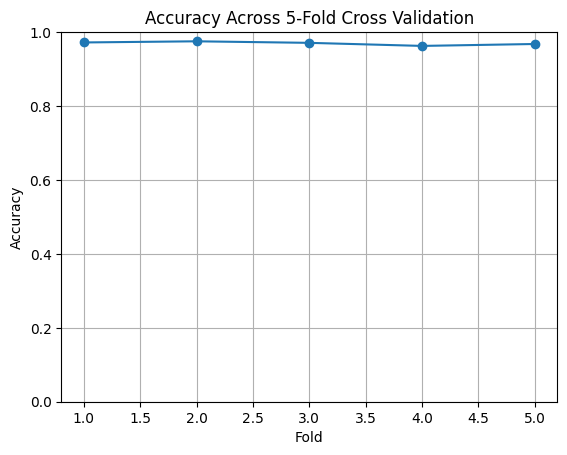

Mean Accuracy: 0.9698


In [45]:
from sklearn.model_selection import StratifiedKFold
import matplotlib.pyplot as plt

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
accuracies = []

for fold, (train_idx, test_idx) in enumerate(skf.split(X, Y)):
    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = Y[train_idx], Y[test_idx]

    rf = RandomForestClassifier(n_estimators=100, max_depth=5, random_state=42)
    rf.fit(X_train, y_train)
    y_pred = rf.predict(X_test)
    
    acc = accuracy_score(y_test, y_pred)
    accuracies.append(acc)
    print(f"Fold {fold+1} Accuracy: {acc:.4f}")

# Plot fold-wise accuracies
plt.plot(range(1, 6), accuracies, marker='o')
plt.title("Accuracy Across 5-Fold Cross Validation")
plt.xlabel("Fold")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.grid(True)
plt.show()

print(f"Mean Accuracy: {np.mean(accuracies):.4f}")


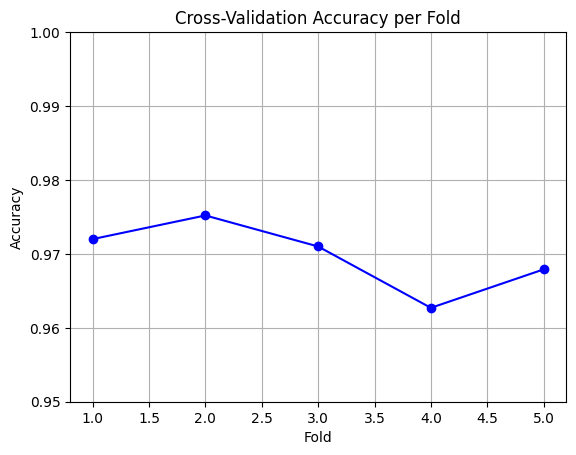

In [46]:
import matplotlib.pyplot as plt

accuracies = [0.9720, 0.9752, 0.9710, 0.9627, 0.9679]

plt.plot(range(1, 6), accuracies, marker='o', linestyle='-', color='blue')
plt.title("Cross-Validation Accuracy per Fold")
plt.xlabel("Fold")
plt.ylabel("Accuracy")
plt.ylim(0.95, 1.0)
plt.grid(True)
plt.show()


Feature ranking:
1. feature 0 (0.193136)
2. feature 1 (0.154491)
3. feature 9 (0.115809)
4. feature 5 (0.087862)
5. feature 2 (0.078188)
6. feature 10 (0.068838)
7. feature 4 (0.059663)
8. feature 7 (0.049333)
9. feature 11 (0.049234)
10. feature 3 (0.039688)
11. feature 8 (0.039252)
12. feature 22 (0.020712)
13. feature 20 (0.011282)
14. feature 15 (0.010829)
15. feature 12 (0.002666)
16. feature 18 (0.002053)
17. feature 14 (0.001964)
18. feature 23 (0.001912)
19. feature 21 (0.001728)
20. feature 26 (0.001624)
21. feature 13 (0.001613)
22. feature 25 (0.001572)
23. feature 19 (0.001508)
24. feature 6 (0.001401)
25. feature 17 (0.001280)
26. feature 24 (0.001270)
27. feature 16 (0.001095)


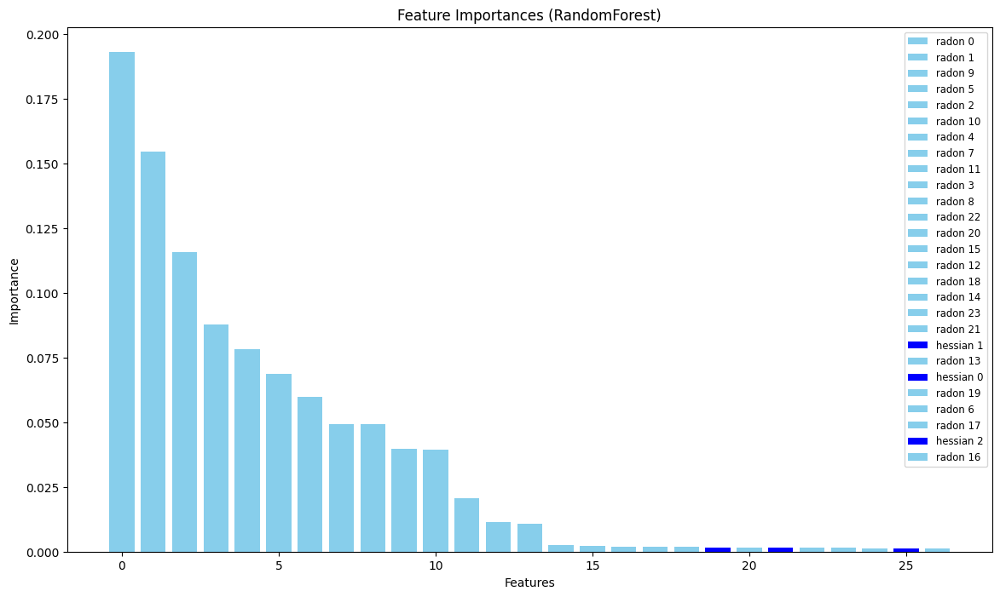

In [47]:
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# Train the RandomForest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, max_depth=5, random_state=42)
rf_classifier.fit(X_train, y_train)

# Retrieve feature importances
importances = rf_classifier.feature_importances_

# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Define custom feature names for selected features
custom_feature_names = {
    25: 'hessian 0',
    26: 'hessian 1',
    24: 'hessian 2'
}

# Plot the feature importances 
plt.figure(figsize=(14, 8))  # Set the figure size to be larger
plt.title("Feature Importances (RandomForest)")

# Plot top 3 features with custom names, others with numerical indices
for i in range(X_train.shape[1]):
    color = "blue" if custom_feature_names.get(indices[i], None) else "skyblue"  # Set color based on feature name
    label = custom_feature_names.get(indices[i], f'radon {indices[i]}')
    plt.bar(i, importances[indices[i]], color=color, align="center", label=label)

plt.xlabel("Features")
plt.ylabel("Importance")
plt.legend(fontsize='small')  # Set legend size to small
plt.show()

In [48]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from xgboost import XGBClassifier
import numpy as np
import pickle

# Assuming you have X and Y defined
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Train the XGBoost classifier
xgb_classifier = XGBClassifier()
xgb_classifier.fit(X_train, y_train)

# Predict labels for the testing set
y_pred = xgb_classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

# Print classification report
class_report = classification_report(y_test, y_pred)
print("Classification Report:")
print(class_report)

# Calculate Sensitivity
TP = conf_matrix[1, 1]
FN = conf_matrix[1, 0]
sensitivity = TP / (TP + FN)
print("Sensitivity:", sensitivity)

# Calculate False Positive Rate (FPR)
FP = conf_matrix[0, 1]
TN = conf_matrix[0, 0]
FPR = TN/ (TN + FP)
print("Specificity:", FPR)

# Save the model
with open('xgb_classifier_model.pkl', 'wb') as file:
    pickle.dump(xgb_classifier, file)

Accuracy: 0.968944099378882
Confusion Matrix:
[[300  22]
 [  8 636]]
Classification Report:
              precision    recall  f1-score   support

         0.0       0.97      0.93      0.95       322
         1.0       0.97      0.99      0.98       644

    accuracy                           0.97       966
   macro avg       0.97      0.96      0.96       966
weighted avg       0.97      0.97      0.97       966

Sensitivity: 0.9875776397515528
Specificity: 0.9316770186335404


Feature ranking:
1. feature 1 (0.406279)
2. feature 0 (0.306933)
3. feature 2 (0.080465)
4. feature 4 (0.039109)
5. feature 22 (0.017679)
6. feature 18 (0.013985)
7. feature 12 (0.011504)
8. feature 3 (0.011338)
9. feature 13 (0.011105)
10. feature 17 (0.010450)
11. feature 14 (0.010346)
12. feature 6 (0.009413)
13. feature 15 (0.009148)
14. feature 25 (0.008178)
15. feature 24 (0.008126)
16. feature 16 (0.008074)
17. feature 26 (0.007633)
18. feature 8 (0.007161)
19. feature 5 (0.006255)
20. feature 11 (0.005578)
21. feature 20 (0.004761)
22. feature 23 (0.003208)
23. feature 19 (0.002102)
24. feature 7 (0.001172)
25. feature 9 (0.000000)
26. feature 10 (0.000000)
27. feature 21 (0.000000)


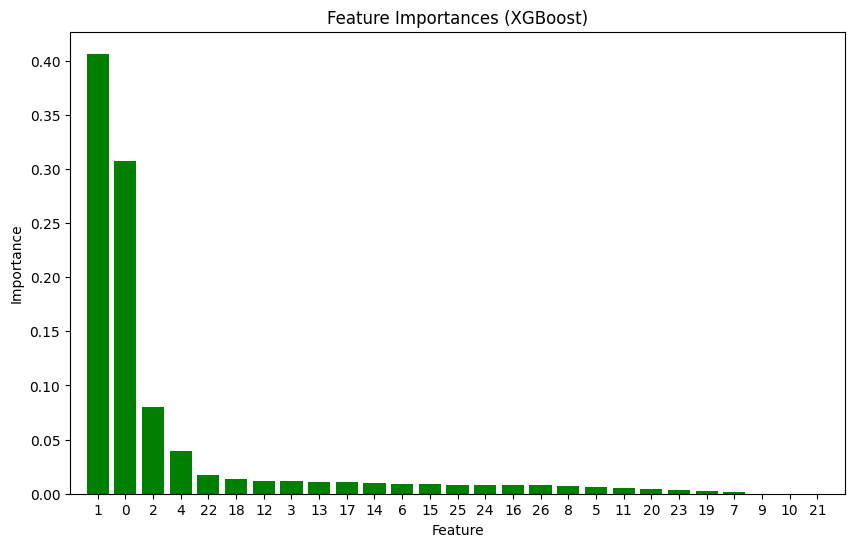

In [49]:
from xgboost import XGBClassifier
import matplotlib.pyplot as plt

# Train the XGBoost classifier
xgb_classifier = XGBClassifier()
xgb_classifier.fit(X_train, y_train)

# Retrieve feature importances
importances = xgb_classifier.feature_importances_

# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature Importances (XGBoost)")
plt.bar(range(X_train.shape[1]), importances[indices], color="g", align="center")
plt.xticks(range(X_train.shape[1]), indices)
plt.xlim([-1, X_train.shape[1]])
plt.xlabel("Feature")
plt.ylabel("Importance")
plt.show()

Prediction in new dataset 

In [50]:
import pickle

model_path = 'rf_classifier_model.pkl'  # Change the path if it's different
with open(model_path, 'rb') as model_file:
    trained_model = pickle.load(model_file)

In [51]:
import pickle

model_path = 'rf_classifier_model.pkl'  # Change the path if it's different
with open(model_path, 'rb') as model_file:
    trained_model = pickle.load(model_file)

In [52]:
# Assuming you have the coordinate (129, 167, 55)
test_coordinate = (120, 150, 70)
roi_size = 10  # Same as the one used during feature extraction

swi_img = nib.load('14_T4_MRI_SWI_BFC_50mm_HM_sCMB_V1.nii.gz')  # Provide the correct path
swi_data = swi_img.get_fdata()

# Extract the ROI around the given coordinate
test_roi = extract_roi(swi_data, [test_coordinate], roi_size)[0]

# Compute Hessian matrix and eigenvalues for the ROI
eigenvalues_test_roi, _ = compute_hessian_eigenvalues(test_roi)

# Compute Radon features for the ROI
angles = np.arange(0, 180, 15)
radon_features_test_roi = compute_radon_features([test_roi], angles)
# Compute Radon shape features for the ROI
fmean_test_roi, fstd_test_roi = compute_radon_shape_features(radon_features_test_roi)
# Combine the features
flattened_radon_values_test_roi = np.concatenate((fmean_test_roi.flatten(), fstd_test_roi.flatten()))
combined_features_test_roi = np.concatenate((flattened_radon_values_test_roi, np.array(compute_hessian_shape_features(eigenvalues_test_roi))))

# Reshape the features to match the input format expected by the model
features_for_prediction = combined_features_test_roi.reshape(1, -1)

FileNotFoundError: No such file or no access: '14_T4_MRI_SWI_BFC_50mm_HM_sCMB_V1.nii.gz'

In [ ]:
prediction = trained_model.predict(features_for_prediction)
print(f"Prediction for coordinate {test_coordinate}: {prediction}")

Prediction for coordinate (120, 150, 70): [1.]


In [3]:
import os
import numpy as np
import nibabel as nib
import SimpleITK as sitk
from skimage.exposure import equalize_adapthist
from skimage.feature import blob_log, hessian_matrix, hessian_matrix_eigvals
from skimage.transform import radon

# --- Configuration ----------------------------------------------------------
DATA_FOLDER = 'chunk'
OUTPUT_FOLDER = 'roi_inspection_2d_large'
N4_ITERATIONS = [50, 50, 30, 20]
CLAHE_CLIP = 0.03
LOGB_SIGMA_MIN = 0.4
LOGB_SIGMA_MAX = 5.0
LOGB_NUM_SIGMA = 20
LOGB_THRESHOLD = 0.1

# --- Helper functions -------------------------------------------------------
def load_nifti(path):
    print(f"[load_nifti] Loading: {path}")
    img = nib.load(path)
    data = img.get_fdata()
    print(f"[load_nifti] Shape: {data.shape}, dtype: {data.dtype}")
    return data, img.affine, img.header


def save_nifti(data, affine, header, path):
    print(f"[save_nifti] Saving to: {path}")
    nib.save(nib.Nifti1Image(data, affine, header), path)


def n4_bias_field_correction(np_img):
    print("[n4_bias_field_correction] Start N4 correction")
    sitk_img = sitk.GetImageFromArray(np_img.astype(np.float32))
    corrector = sitk.N4BiasFieldCorrectionImageFilter()
    corrector.SetMaximumNumberOfIterations(N4_ITERATIONS)
    corrected = corrector.Execute(sitk_img)
    print("[n4_bias_field_correction] Done N4 correction")
    return sitk.GetArrayFromImage(corrected)


def skull_strip_otsu(np_img):
    print("[skull_strip_otsu] Start skull stripping")
    sitk_img = sitk.GetImageFromArray(np_img.astype(np.float32))
    otsu = sitk.OtsuThresholdImageFilter()
    otsu.SetInsideValue(0)
    otsu.SetOutsideValue(1)
    mask = otsu.Execute(sitk_img)
    cc = sitk.ConnectedComponentImageFilter()
    labels = cc.Execute(mask)
    stats = sitk.LabelShapeStatisticsImageFilter()
    stats.Execute(labels)
    largest = max(stats.GetLabels(), key=lambda L: stats.GetNumberOfPixels(L))
    brain_mask = sitk.BinaryThreshold(labels, largest, largest, 1, 0)
    brain_mask = sitk.BinaryMorphologicalClosing(brain_mask, (5,5,5))
    stripped = sitk.Mask(sitk_img, brain_mask)
    print("[skull_strip_otsu] Done skull stripping")
    return sitk.GetArrayFromImage(stripped)


def preprocess_volume(np_img, idx):
    print(f"[preprocess_volume] Volume {idx}: Start preprocessing")
    img_n4 = n4_bias_field_correction(np_img)
    img_ss = skull_strip_otsu(img_n4)
    p99 = np.percentile(img_ss, 99)
    v = np.clip(img_ss, 0, p99) / p99
    v = 1.0 - v
    print(f"[preprocess_volume] Volume {idx}: Applying CLAHE")
    v = equalize_adapthist(v, clip_limit=CLAHE_CLIP)
    print(f"[preprocess_volume] Volume {idx}: Applying diffusion")
    sitk_v = sitk.GetImageFromArray(v.astype(np.float32))
    diff = sitk.CurvatureAnisotropicDiffusionImageFilter()
    diff.SetNumberOfIterations(20)
    diff.SetTimeStep(0.04)
    smooth = diff.Execute(sitk_v)
    print(f"[preprocess_volume] Volume {idx}: Preprocessing complete")
    return sitk.GetArrayFromImage(smooth)


def detect_candidates(vol, idx):
    print(f"[detect_candidates] Volume {idx}: Detecting blobs")
    blobs = blob_log(vol,
                     min_sigma=LOGB_SIGMA_MIN,
                     max_sigma=LOGB_SIGMA_MAX,
                     num_sigma=LOGB_NUM_SIGMA,
                     threshold=LOGB_THRESHOLD)
    blobs[:, 3] *= np.sqrt(3)
    print(f"[detect_candidates] Volume {idx}: Found {len(blobs)} blobs")
    return blobs


def extract_features(vol, blobs, idx):
    print(f"[extract_features] Volume {idx}: {len(blobs)} candidates to process")
    feats = []
    for i, (z, y, x, r) in enumerate(blobs):
        z, y, x, r = map(int, (z, y, x, r))
        sz = max(1, r)
        patch = vol[max(0,z-sz):z+sz, max(0,y-sz):y+sz, max(0,x-sz):x+sz]
        if patch.shape[0] < 3 or patch.shape[1] < 3:
            print(f"  [extract_features] Skip {i}: too small {patch.shape}")
            continue
        mid = patch.shape[0] // 2
        H = hessian_matrix(patch[mid], sigma=sz)
        eigs = hessian_matrix_eigvals(H)
        lam = list(np.abs(eigs))
        if len(lam) == 2:
            lam.append(lam[1])
        lam = np.sort(np.stack(lam), axis=0)
        lam1, lam2, lam3 = lam[0], lam[1], lam[2]
        fSphere = lam1 / (np.sqrt(lam2 * lam3) + 1e-6)
        fFA = np.std([lam1, lam2, lam3]) / (np.mean([lam1, lam2, lam3]) + 1e-6)
        slice2d = patch[mid]
        theta = np.linspace(0., 180., max(slice2d.shape), endpoint=False)
        R = radon(slice2d, theta=theta, circle=False)
        radon_mean = np.mean(R)
        radon_std = np.std(R)
        feats.append([np.mean(fSphere), np.mean(fFA), np.mean(patch), np.std(patch), radon_mean, radon_std])
    feats = np.array(feats)
    print(f"[extract_features] Volume {idx}: Extracted features shape {feats.shape}")
    return feats

# --- Main pipeline ----------------------------------------------------------
if __name__ == '__main__':
    print(f"Script started. DATA_FOLDER={DATA_FOLDER}, OUTPUT_FOLDER={OUTPUT_FOLDER}")
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)

    nii_paths = sorted([os.path.join(DATA_FOLDER, f)
                        for f in os.listdir(DATA_FOLDER)
                        if f.endswith('.nii') or f.endswith('.nii.gz')])
    print(f"Found {len(nii_paths)} NIfTI files.")

    vols, affines, headers = zip(*(load_nifti(p) for p in nii_paths))

    preprocessed = []
    for idx, v in enumerate(vols):
        print(f"-- Processing volume {idx+1}/{len(vols)} --")
        preprocessed.append(preprocess_volume(v, idx))

    candidate_list = []
    for idx, vol in enumerate(preprocessed):
        candidate_list.append(detect_candidates(vol, idx))

    for idx, (vol, blobs) in enumerate(zip(preprocessed, candidate_list)):
        feats = extract_features(vol, blobs, idx)
        print(f"Final features for volume {idx}:\n", feats)
        out_csv = os.path.join(OUTPUT_FOLDER, f'features_{idx}.csv')
        print(f"Saving features to {out_csv}")
        np.savetxt(out_csv, feats, delimiter=',')

    print("Script finished successfully.")

Script started. DATA_FOLDER=chunk, OUTPUT_FOLDER=roi_inspection_2d_large
Found 1 NIfTI files.
[load_nifti] Loading: chunk\101_T1_MRI_SWI_BFC_50mm_HM_sCMB_V1.nii.gz
[load_nifti] Shape: (176, 256, 80), dtype: float64
-- Processing volume 1/1 --
[preprocess_volume] Volume 0: Start preprocessing
[n4_bias_field_correction] Start N4 correction
[n4_bias_field_correction] Done N4 correction
[skull_strip_otsu] Start skull stripping
[skull_strip_otsu] Done skull stripping
[preprocess_volume] Volume 0: Applying CLAHE
[preprocess_volume] Volume 0: Applying diffusion
[preprocess_volume] Volume 0: Preprocessing complete
[detect_candidates] Volume 0: Detecting blobs
[detect_candidates] Volume 0: Found 13224 blobs
[extract_features] Volume 0: 13224 candidates to process
  [extract_features] Skip 0: too small (2, 2, 2)
  [extract_features] Skip 1: too small (2, 2, 2)
  [extract_features] Skip 2: too small (2, 2, 2)
  [extract_features] Skip 3: too small (2, 2, 2)
  [extract_features] Skip 4: too small 

C:\Users\Dell\AppData\Local\Temp\ipykernel_2384\644403887.py:104: FutureWarning: use_gaussian_derivatives currently defaults to False, but will change to True in a future version. Please specify this argument explicitly to maintain the current behavior
  H = hessian_matrix(patch[mid], sigma=sz)


  [extract_features] Skip 12094: too small (2, 2, 2)
  [extract_features] Skip 12095: too small (2, 2, 2)
  [extract_features] Skip 12096: too small (2, 2, 2)
  [extract_features] Skip 12097: too small (2, 2, 2)
  [extract_features] Skip 12099: too small (2, 2, 2)
  [extract_features] Skip 12101: too small (2, 2, 2)
  [extract_features] Skip 12102: too small (2, 2, 2)
  [extract_features] Skip 12104: too small (2, 2, 2)
  [extract_features] Skip 12107: too small (2, 2, 2)
  [extract_features] Skip 12108: too small (2, 2, 2)
  [extract_features] Skip 12111: too small (2, 2, 2)
  [extract_features] Skip 12115: too small (2, 2, 2)
  [extract_features] Skip 12119: too small (2, 2, 2)
  [extract_features] Skip 12122: too small (2, 2, 2)
  [extract_features] Skip 12124: too small (2, 2, 2)
  [extract_features] Skip 12126: too small (2, 2, 2)
  [extract_features] Skip 12127: too small (2, 2, 2)
  [extract_features] Skip 12128: too small (2, 2, 2)
  [extract_features] Skip 12132: too small (2,

In [7]:
import numpy as np
data = np.load('detected_features.npy')
print(data)

[[0.         0.03128728 0.06182079 ... 1.         0.7499669  0.9999617 ]
 [0.         0.00630277 0.01259271 ... 1.         0.09942935 0.35562614]
 [0.         0.02541953 0.05026908 ... 0.99999999 0.57932499 0.83293221]
 ...
 [0.         0.03128749 0.06182122 ... 1.         0.7499806  0.99997649]
 [0.         0.02939904 0.05732195 ... 0.99999999 0.25904635 0.58174951]
 [0.         0.01273254 0.02507245 ... 1.         0.24287832 0.57239587]]


In [9]:
import numpy as np
data1 = np.load('detected_labels.npy')
print(data1.shape)
      

(6260,)


In [14]:
import os
import numpy as np
import nibabel as nib
from scipy.ndimage import gaussian_filter, zoom, map_coordinates
from scipy.linalg import eig
import pandas as pd
import matplotlib.pyplot as plt

# --- Configuration ----------------------------------------------------------
DATA_FOLDER = 'chunk'
OUTPUT_FOLDER = 'roi_inspection_3d'
EXCEL_FILE = 'sCmb_filteredV5_output-small.xlsx'
ROI_SIZE = (24, 24, 20)  # As per paper
UPSCALE_FACTOR = 2
GAMMA = 2.5  # Hessian normalization factor
RADON_ANGLES = np.arange(0, 180, 15)
ROI_DEBUG_FOLDER = os.path.join(OUTPUT_FOLDER, 'debug_rois')

# --- Helper functions -------------------------------------------------------
def load_nifti(path):
    print(f"Loading NIfTI file: {path}")
    img = nib.load(path)
    data = img.get_fdata()
    print(f"  Shape: {data.shape}, dtype: {data.dtype}")
    return data


def load_coordinates_from_excel(excel_file, nifti_filename):
    print(f"Loading coordinates from {excel_file} for {nifti_filename}")
    df = pd.read_excel(excel_file)
    coords = []
    for _, row in df[df['NIFTI'] == nifti_filename].iterrows():
        for i in range(1, len(row), 3):
            try:
                if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                    x, y, z = int(row.iloc[i]), int(row.iloc[i+1]), int(row.iloc[i+2])
                    coords.append([z, y, x])  # Convert to (z, y, x) for NIfTI
            except (ValueError, TypeError):
                pass
    print(f"  Loaded {len(coords)} coordinates: {coords}")
    return np.array(coords)


def save_roi_slice(roi, coord, idx, i, suffix='error'):
    """Save central slice of ROI as PNG for debugging."""
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)
    z, y, x = coord
    mid_z = roi.shape[0] // 2
    plt.figure()
    plt.imshow(roi[mid_z], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_{suffix}.png'))
    plt.close()


def extract_roi(vol, coord, roi_size=ROI_SIZE, upscale_factor=UPSCALE_FACTOR):
    z, y, x = map(int, coord)
    x_size, y_size, z_size = roi_size
    x_start = max(0, x - x_size // 2)
    x_end = min(vol.shape[2], x + (x_size + 1) // 2)
    y_start = max(0, y - y_size // 2)
    y_end = min(vol.shape[1], y + (y_size + 1) // 2)
    z_start = max(0, z - z_size // 2)
    z_end = min(vol.shape[0], z + (z_size + 1) // 2)
    
    roi = vol[z_start:z_end, y_start:y_end, x_start:x_end]
    
    pad_x = x_size - roi.shape[2]
    pad_y = y_size - roi.shape[1]
    pad_z = z_size - roi.shape[0]
    if pad_x > 0 or pad_y > 0 or pad_z > 0:
        roi = np.pad(roi, ((max(0, pad_z//2), max(0, pad_z - pad_z//2)),
                           (max(0, pad_y//2), max(0, pad_y - pad_y//2)),
                           (max(0, pad_x//2), max(0, pad_x - pad_x//2))),
                     mode='constant', constant_values=0)
    
    if roi.shape != (z_size, y_size, x_size):
        return None
    
    # Check ROI content
    if np.std(roi) < 1e-6:
        return None
    
    if upscale_factor > 1:
        roi = zoom(roi, upscale_factor, order=1)
    return roi


def compute_hessian_eigenvalues(roi, sigma=1.0, gamma=GAMMA):
    smoothed_roi = gaussian_filter(roi, sigma=sigma)
    dxx = gaussian_filter(smoothed_roi, sigma=sigma, order=[2, 0, 0])
    dyy = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 2, 0])
    dzz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 0, 2])
    dxy = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 1, 0])
    dxz = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 0, 1])
    dyz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 1, 1])
    
    center = np.array(roi.shape) // 2
    hessian_matrix = np.array([
        [dxx[tuple(center)], dxy[tuple(center)], dxz[tuple(center)]],
        [dxy[tuple(center)], dyy[tuple(center)], dyz[tuple(center)]],
        [dxz[tuple(center)], dyz[tuple(center)], dzz[tuple(center)]]
    ])
    
    hessian_matrix = (sigma ** gamma) * hessian_matrix
    
    try:
        eigenvalues, eigenvectors = eig(hessian_matrix)
        eigenvalues = np.real(eigenvalues)  # Ensure real eigenvalues
        if np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
            return np.zeros(3), np.zeros((3, 3))
        eigenvalues = np.sort(np.abs(eigenvalues))[::-1]
        return eigenvalues, eigenvectors
    except np.linalg.LinAlgError:
        print("Hessian eigenvalue computation failed")
        return np.zeros(3), np.zeros((3, 3))


def compute_hessian_shape_features(eigenvalues, eigenvectors):
    if len(eigenvalues) != 3 or np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
        print("Invalid eigenvalues for Hessian features")
        return 0, 0, 0, 0
    
    lambda_1, lambda_2, lambda_3 = np.sort(np.abs(eigenvalues))
    
    f_sphere = lambda_1 / np.sqrt(lambda_2 * lambda_3) if lambda_2 * lambda_3 > 0 else 0
    f_lc = lambda_2 / lambda_3 if lambda_3 > 0 else 0
    f_fa = np.sqrt(0.5) * np.sqrt(
        (lambda_1 - lambda_2)**2 + (lambda_2 - lambda_3)**2 + (lambda_1 - lambda_3)**2
    ) / np.sqrt(lambda_1**2 + lambda_2**2 + lambda_3**2) if np.sum(lambda_1**2 + lambda_2**2 + lambda_3**2) > 0 else 0
    
    largest_eigenvector = eigenvectors[:, np.argmax(np.abs(eigenvalues))]
    xy_normal = np.array([0, 0, 1])
    cos_theta = np.dot(largest_eigenvector, xy_normal) / (np.linalg.norm(largest_eigenvector) * np.linalg.norm(xy_normal) + 1e-10)
    f_o = np.arccos(np.abs(cos_theta)) * 180 / np.pi
    
    return f_sphere, f_lc, f_fa, f_o


def compute_radon_features(roi, theta=RADON_ANGLES, phi=RADON_ANGLES):
    roi = (roi - np.min(roi)) / (np.max(roi) - np.min(roi) + 1e-10)
    radon_features = []
    
    for t in theta:
        for p in phi:
            t_rad, p_rad = np.deg2rad(t), np.deg2rad(p)
            rot_matrix = np.array([
                [np.cos(p_rad), 0, np.sin(p_rad)],
                [0, 1, 0],
                [-np.sin(p_rad), 0, np.cos(p_rad)]
            ]) @ np.array([
                [np.cos(t_rad), -np.sin(t_rad), 0],
                [np.sin(t_rad), np.cos(t_rad), 0],
                [0, 0, 1]
            ])
            rotated_roi = map_coordinates(roi, np.array([rot_matrix @ np.array([i, j, k])
                                                        for i in range(roi.shape[0])
                                                        for j in range(roi.shape[1])
                                                        for k in range(roi.shape[2])]).T,
                                         order=1).reshape(roi.shape)
            projection = np.sum(rotated_roi, axis=2)
            radon_features.append(projection)
    
    radon_features = np.stack(radon_features, axis=-1)
    fmean = np.mean(radon_features, axis=(0, 1))
    fstd = np.std(radon_features, axis=(0, 1))
    
    return radon_features, fmean, fstd


def extract_features(vol, coords, idx):
    print(f"Extracting features for Volume {idx}, {len(coords)} microbleeds...")
    feats = []
    for i, coord in enumerate(coords):
        roi = extract_roi(vol, coord)
        if roi is None:
            print(f"  Skipping microbleed {i} at {coord}: Invalid ROI (std={np.std(roi) if roi is not None else 'None'})")
            save_roi_slice(vol[coord[0]-10:coord[0]+10, coord[1]-10:coord[1]+10, coord[2]-10:coord[2]+10], 
                          coord, idx, i, suffix='invalid_roi')
            continue
        
        # Save ROI slice for inspection
        save_roi_slice(roi, coord, idx, i, suffix='valid')
        
        # Hessian features
        eigenvalues, eigenvectors = compute_hessian_eigenvalues(roi)
        if np.all(np.abs(eigenvalues) < 1e-10):
            print(f"  Skipping microbleed {i} at {coord}: Zero eigenvalues")
            save_roi_slice(roi, coord, idx, i, suffix='zero_eigenvalues')
            continue
        f_sphere, f_lc, f_fa, f_o = compute_hessian_shape_features(eigenvalues, eigenvectors)
        hessian_features = np.array([f_sphere, f_lc, f_fa, f_o])
        
        # Radon features
        _, fmean_radon, fstd_radon = compute_radon_features(roi)
        radon_features = np.concatenate([fmean_radon, fstd_radon])
        
        # Combine features
        combined_features = np.concatenate([hessian_features, radon_features, [np.mean(roi), np.std(roi)]])
        feats.append(combined_features)
    
    feats = np.array(feats)
    print(f"  Extracted feature matrix shape: {feats.shape}")
    return feats


# --- Main pipeline ----------------------------------------------------------
if __name__ == '__main__':
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)

    print(f"Reading Excel file: {EXCEL_FILE}")
    df = pd.read_excel(EXCEL_FILE)
    nifti_filenames = df['NIFTI'].unique()

    for idx, nifti_filename in enumerate(nifti_filenames):
        nifti_path = os.path.join(DATA_FOLDER, nifti_filename)
        if not os.path.exists(nifti_path):
            print(f"Skipping {nifti_filename}: File not found")
            continue
        
        vol = load_nifti(nifti_path)
        
        coords = load_coordinates_from_excel(EXCEL_FILE, nifti_filename)
        if len(coords) == 0:
            print(f"No coordinates for {nifti_filename}, skipping...")
            continue
        
        feats = extract_features(vol, coords, idx)
        if feats.size == 0:
            print(f"No valid features extracted for {nifti_filename}")
            continue
        
        output_file = os.path.join(OUTPUT_FOLDER, f'features_{idx}.csv')
        np.savetxt(output_file, feats, delimiter=',', 
                   header='f_sphere,f_lc,f_fa,f_o,' + 
                          ','.join([f'radon_mean_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   [f'radon_std_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   ['patch_mean,patch_std']))
        print(f"Saved features to {output_file}")

Reading Excel file: sCmb_filteredV5_output-small.xlsx
Loading NIfTI file: chunk\3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Shape: (176, 256, 80), dtype: float64
Loading coordinates from sCmb_filteredV5_output-small.xlsx for 3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Loaded 1 coordinates: [[55, 173, 77]]
Extracting features for Volume 0, 1 microbleeds...
  Extracted feature matrix shape: (1, 294)
Saved features to roi_inspection_3d\features_0.csv


In [17]:
import os
import numpy as np
import nibabel as nib
from scipy.ndimage import gaussian_filter, zoom, map_coordinates
from scipy.linalg import eig
import pandas as pd
import matplotlib.pyplot as plt

# --- Configuration ----------------------------------------------------------
DATA_FOLDER = 'chunk'
OUTPUT_FOLDER = 'roi_inspection_3d'
EXCEL_FILE = 'sCmb_filteredV5_output-small.xlsx'
ROI_SIZE = (24, 24, 20)  # As per paper
UPSCALE_FACTOR = 2
GAMMA = 2.5  # Hessian normalization factor
RADON_ANGLES = np.arange(0, 180, 15)
ROI_DEBUG_FOLDER = os.path.join(OUTPUT_FOLDER, 'debug_rois')

# --- Helper functions -------------------------------------------------------
def load_nifti(path):
    print(f"Loading NIfTI file: {path}")
    img = nib.load(path)
    data = img.get_fdata()
    print(f"  Shape: {data.shape}, dtype: {data.dtype}")
    return data


def load_coordinates_from_excel(excel_file, nifti_filename):
    print(f"Loading coordinates from {excel_file} for {nifti_filename}")
    df = pd.read_excel(excel_file)
    coords = []
    for _, row in df[df['NIFTI'] == nifti_filename].iterrows():
        for i in range(1, len(row), 3):
            try:
                if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                    x, y, z = int(row.iloc[i]), int(row.iloc[i+1]), int(row.iloc[i+2])
                    coords.append([z, y, x])  # Convert to (z, y, x) for NIfTI
            except (ValueError, TypeError):
                pass
    print(f"  Loaded {len(coords)} coordinates: {coords}")
    return np.array(coords)


def save_roi_views(roi, coord, idx, i, suffix='valid'):
    """Save axial (xy), sagittal (xz), and coronal (yz) views of ROI as PNG."""
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)
    z, y, x = coord
    
    # Axial view (xy-plane, central z-slice)
    mid_z = roi.shape[0] // 2
    plt.figure()
    plt.imshow(roi[mid_z], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Axial {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_axial_{suffix}.png'))
    plt.close()
    
    # Sagittal view (xz-plane, central y-slice)
    mid_y = roi.shape[1] // 2
    plt.figure()
    plt.imshow(roi[:, mid_y, :], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Sagittal {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_sagittal_{suffix}.png'))
    plt.close()
    
    # Coronal view (yz-plane, central x-slice)
    mid_x = roi.shape[2] // 2
    plt.figure()
    plt.imshow(roi[:, :, mid_x], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Coronal {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_coronal_{suffix}.png'))
    plt.close()


def extract_roi(vol, coord, roi_size=ROI_SIZE, upscale_factor=UPSCALE_FACTOR):
    z, y, x = map(int, coord)
    x_size, y_size, z_size = roi_size
    x_start = max(0, x - x_size // 2)
    x_end = min(vol.shape[2], x + (x_size + 1) // 2)
    y_start = max(0, y - y_size // 2)
    y_end = min(vol.shape[1], y + (y_size + 1) // 2)
    z_start = max(0, z - z_size // 2)
    z_end = min(vol.shape[0], z + (z_size + 1) // 2)
    
    roi = vol[z_start:z_end, y_start:y_end, x_start:x_end]
    
    pad_x = x_size - roi.shape[2]
    pad_y = y_size - roi.shape[1]
    pad_z = z_size - roi.shape[0]
    if pad_x > 0 or pad_y > 0 or pad_z > 0:
        roi = np.pad(roi, ((max(0, pad_z//2), max(0, pad_z - pad_z//2)),
                           (max(0, pad_y//2), max(0, pad_y - pad_y//2)),
                           (max(0, pad_x//2), max(0, pad_x - pad_x//2))),
                     mode='constant', constant_values=0)
    
    if roi.shape != (z_size, y_size, x_size):
        return None
    
    # Check ROI content
    if np.std(roi) < 1e-6:
        return None
    
    if upscale_factor > 1:
        roi = zoom(roi, upscale_factor, order=1)
    return roi


def compute_hessian_eigenvalues(roi, sigma=1.0, gamma=GAMMA):
    smoothed_roi = gaussian_filter(roi, sigma=sigma)
    dxx = gaussian_filter(smoothed_roi, sigma=sigma, order=[2, 0, 0])
    dyy = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 2, 0])
    dzz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 0, 2])
    dxy = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 1, 0])
    dxz = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 0, 1])
    dyz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 1, 1])
    
    center = np.array(roi.shape) // 2
    hessian_matrix = np.array([
        [dxx[tuple(center)], dxy[tuple(center)], dxz[tuple(center)]],
        [dxy[tuple(center)], dyy[tuple(center)], dyz[tuple(center)]],
        [dxz[tuple(center)], dyz[tuple(center)], dzz[tuple(center)]]
    ])
    
    hessian_matrix = (sigma ** gamma) * hessian_matrix
    
    try:
        eigenvalues, eigenvectors = eig(hessian_matrix)
        eigenvalues = np.real(eigenvalues)
        if np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
            return np.zeros(3), np.zeros((3, 3))
        eigenvalues = np.sort(np.abs(eigenvalues))[::-1]
        return eigenvalues, eigenvectors
    except np.linalg.LinAlgError:
        print("Hessian eigenvalue computation failed")
        return np.zeros(3), np.zeros((3, 3))


def compute_hessian_shape_features(eigenvalues, eigenvectors):
    if len(eigenvalues) != 3 or np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
        print("Invalid eigenvalues for Hessian features")
        return 0, 0, 0, 0
    
    lambda_1, lambda_2, lambda_3 = np.sort(np.abs(eigenvalues))
    
    f_sphere = lambda_1 / np.sqrt(lambda_2 * lambda_3) if lambda_2 * lambda_3 > 0 else 0
    f_lc = lambda_2 / lambda_3 if lambda_3 > 0 else 0
    f_fa = np.sqrt(0.5) * np.sqrt(
        (lambda_1 - lambda_2)**2 + (lambda_2 - lambda_3)**2 + (lambda_1 - lambda_3)**2
    ) / np.sqrt(lambda_1**2 + lambda_2**2 + lambda_3**2) if np.sum(lambda_1**2 + lambda_2**2 + lambda_3**2) > 0 else 0
    
    largest_eigenvector = eigenvectors[:, np.argmax(np.abs(eigenvalues))]
    xy_normal = np.array([0, 0, 1])
    cos_theta = np.dot(largest_eigenvector, xy_normal) / (np.linalg.norm(largest_eigenvector) * np.linalg.norm(xy_normal) + 1e-10)
    f_o = np.arccos(np.abs(cos_theta)) * 180 / np.pi
    
    return f_sphere, f_lc, f_fa, f_o


def compute_radon_features(roi, theta=RADON_ANGLES, phi=RADON_ANGLES):
    roi = (roi - np.min(roi)) / (np.max(roi) - np.min(roi) + 1e-10)
    radon_features = []
    
    for t in theta:
        for p in phi:
            t_rad, p_rad = np.deg2rad(t), np.deg2rad(p)
            rot_matrix = np.array([
                [np.cos(p_rad), 0, np.sin(p_rad)],
                [0, 1, 0],
                [-np.sin(p_rad), 0, np.cos(p_rad)]
            ]) @ np.array([
                [np.cos(t_rad), -np.sin(t_rad), 0],
                [np.sin(t_rad), np.cos(t_rad), 0],
                [0, 0, 1]
            ])
            rotated_roi = map_coordinates(roi, np.array([rot_matrix @ np.array([i, j, k])
                                                        for i in range(roi.shape[0])
                                                        for j in range(roi.shape[1])
                                                        for k in range(roi.shape[2])]).T,
                                         order=1).reshape(roi.shape)
            projection = np.sum(rotated_roi, axis=2)
            radon_features.append(projection)
    
    radon_features = np.stack(radon_features, axis=-1)
    fmean = np.mean(radon_features, axis=(0, 1))
    fstd = np.std(radon_features, axis=(0, 1))
    
    return radon_features, fmean, fstd


def extract_features(vol, coords, idx):
    print(f"Extracting features for Volume {idx}, {len(coords)} microbleeds...")
    feats = []
    for i, coord in enumerate(coords):
        roi = extract_roi(vol, coord)
        if roi is None:
            print(f"  Skipping microbleed {i} at {coord}: Invalid ROI (std={np.std(roi) if roi is not None else 'None'})")
            save_roi_views(vol[coord[0]-10:coord[0]+10, coord[1]-10:coord[1]+10, coord[2]-10:coord[2]+10], 
                          coord, idx, i, suffix='invalid_roi')
            continue
        
        # Save axial, sagittal, and coronal views
        save_roi_views(roi, coord, idx, i, suffix='valid')
        
        # Hessian features
        eigenvalues, eigenvectors = compute_hessian_eigenvalues(roi)
        if np.all(np.abs(eigenvalues) < 1e-10):
            print(f"  Skipping microbleed {i} at {coord}: Zero eigenvalues")
            save_roi_views(roi, coord, idx, i, suffix='zero_eigenvalues')
            continue
        f_sphere, f_lc, f_fa, f_o = compute_hessian_shape_features(eigenvalues, eigenvectors)
        hessian_features = np.array([f_sphere, f_lc, f_fa, f_o])
        
        # Radon features
        _, fmean_radon, fstd_radon = compute_radon_features(roi)
        radon_features = np.concatenate([fmean_radon, fstd_radon])
        
        # Combine features
        combined_features = np.concatenate([hessian_features, radon_features, [np.mean(roi), np.std(roi)]])
        feats.append(combined_features)
    
    feats = np.array(feats)
    print(f"  Extracted feature matrix shape: {feats.shape}")
    return feats


# --- Main pipeline ----------------------------------------------------------
if __name__ == '__main__':
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)

    print(f"Reading Excel file: {EXCEL_FILE}")
    df = pd.read_excel(EXCEL_FILE)
    nifti_filenames = df['NIFTI'].unique()

    for idx, nifti_filename in enumerate(nifti_filenames):
        nifti_path = os.path.join(DATA_FOLDER, nifti_filename)
        if not os.path.exists(nifti_path):
            print(f"Skipping {nifti_filename}: File not found")
            continue
        
        vol = load_nifti(nifti_path)
        
        coords = load_coordinates_from_excel(EXCEL_FILE, nifti_filename)
        if len(coords) == 0:
            print(f"No coordinates for {nifti_filename}, skipping...")
            continue
        
        feats = extract_features(vol, coords, idx)
        if feats.size == 0:
            print(f"No valid features extracted for {nifti_filename}")
            continue
        
        output_file = os.path.join(OUTPUT_FOLDER, f'features_{idx}.csv')
        np.savetxt(output_file, feats, delimiter=',', 
                   header='f_sphere,f_lc,f_fa,f_o,' + 
                          ','.join([f'radon_mean_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   [f'radon_std_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   ['patch_mean,patch_std']))
        print(f"Saved features to {output_file}")

Reading Excel file: sCmb_filteredV5_output-small.xlsx
Loading NIfTI file: chunk\3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Shape: (176, 256, 80), dtype: float64
Loading coordinates from sCmb_filteredV5_output-small.xlsx for 3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Loaded 1 coordinates: [[55, 173, 77]]
Extracting features for Volume 0, 1 microbleeds...
  Extracted feature matrix shape: (1, 294)
Saved features to roi_inspection_3d\features_0.csv


In [18]:
import os
import numpy as np
import nibabel as nib
from scipy.ndimage import gaussian_filter, zoom, map_coordinates
from scipy.linalg import eig
import pandas as pd
import matplotlib.pyplot as plt

# --- Configuration ----------------------------------------------------------
DATA_FOLDER = 'chunk'
OUTPUT_FOLDER = 'roi_inspection_3d'
EXCEL_FILE = 'sCmb_filteredV5_output-small.xlsx'
ROI_SIZE = (48, 48, 40)  # Increased from (24, 24, 20) to capture more context
UPSCALE_FACTOR = 2
GAMMA = 2.5  # Hessian normalization factor
RADON_ANGLES = np.arange(0, 180, 15)
ROI_DEBUG_FOLDER = os.path.join(OUTPUT_FOLDER, 'debug_rois')

# --- Helper functions -------------------------------------------------------
def load_nifti(path):
    print(f"Loading NIfTI file: {path}")
    img = nib.load(path)
    data = img.get_fdata()
    print(f"  Shape: {data.shape}, dtype: {data.dtype}")
    return data


def load_coordinates_from_excel(excel_file, nifti_filename):
    print(f"Loading coordinates from {excel_file} for {nifti_filename}")
    df = pd.read_excel(excel_file)
    coords = []
    for _, row in df[df['NIFTI'] == nifti_filename].iterrows():
        for i in range(1, len(row), 3):
            try:
                if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                    x, y, z = int(row.iloc[i]), int(row.iloc[i+1]), int(row.iloc[i+2])
                    coords.append([z, y, x])  # Convert to (z, y, x) for NIfTI
            except (ValueError, TypeError):
                pass
    print(f"  Loaded {len(coords)} coordinates: {coords}")
    return np.array(coords)


def save_roi_views(roi, coord, idx, i, suffix='valid'):
    """Save axial (xy), sagittal (xz), and coronal (yz) views of ROI as PNG."""
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)
    z, y, x = coord
    
    # Axial view (xy-plane, central z-slice)
    mid_z = roi.shape[0] // 2
    plt.figure()
    plt.imshow(roi[mid_z], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Axial {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_axial_{suffix}.png'))
    plt.close()
    
    # Sagittal view (xz-plane, central y-slice)
    mid_y = roi.shape[1] // 2
    plt.figure()
    plt.imshow(roi[:, mid_y, :], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Sagittal {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_sagittal_{suffix}.png'))
    plt.close()
    
    # Coronal view (yz-plane, central x-slice)
    mid_x = roi.shape[2] // 2
    plt.figure()
    plt.imshow(roi[:, :, mid_x], cmap='gray')
    plt.title(f"ROI {i} (z={z}, y={y}, x={x}) - Coronal {suffix}")
    plt.colorbar()
    plt.savefig(os.path.join(ROI_DEBUG_FOLDER, f'vol_{idx}_roi_{i}_z{z}_y{y}_x{x}_coronal_{suffix}.png'))
    plt.close()


def extract_roi(vol, coord, roi_size=ROI_SIZE, upscale_factor=UPSCALE_FACTOR):
    z, y, x = map(int, coord)
    x_size, y_size, z_size = roi_size
    x_start = max(0, x - x_size // 2)
    x_end = min(vol.shape[2], x + (x_size + 1) // 2)
    y_start = max(0, y - y_size // 2)
    y_end = min(vol.shape[1], y + (y_size + 1) // 2)
    z_start = max(0, z - z_size // 2)
    z_end = min(vol.shape[0], z + (z_size + 1) // 2)
    
    roi = vol[z_start:z_end, y_start:y_end, x_start:x_end]
    
    pad_x = x_size - roi.shape[2]
    pad_y = y_size - roi.shape[1]
    pad_z = z_size - roi.shape[0]
    if pad_x > 0 or pad_y > 0 or pad_z > 0:
        roi = np.pad(roi, ((max(0, pad_z//2), max(0, pad_z - pad_z//2)),
                           (max(0, pad_y//2), max(0, pad_y - pad_y//2)),
                           (max(0, pad_x//2), max(0, pad_x - pad_x//2))),
                     mode='constant', constant_values=0)
    
    if roi.shape != (z_size, y_size, x_size):
        print(f"Invalid ROI shape at {coord}: got {roi.shape}, expected {(z_size, y_size, x_size)}")
        return None
    
    # Check ROI content
    if np.std(roi) < 1e-6:
        print(f"Low contrast ROI at {coord}: std={np.std(roi)}")
        return None
    
    if upscale_factor > 1:
        roi = zoom(roi, upscale_factor, order=1)
    return roi


def compute_hessian_eigenvalues(roi, sigma=1.0, gamma=GAMMA):
    smoothed_roi = gaussian_filter(roi, sigma=sigma)
    dxx = gaussian_filter(smoothed_roi, sigma=sigma, order=[2, 0, 0])
    dyy = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 2, 0])
    dzz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 0, 2])
    dxy = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 1, 0])
    dxz = gaussian_filter(smoothed_roi, sigma=sigma, order=[1, 0, 1])
    dyz = gaussian_filter(smoothed_roi, sigma=sigma, order=[0, 1, 1])
    
    center = np.array(roi.shape) // 2
    hessian_matrix = np.array([
        [dxx[tuple(center)], dxy[tuple(center)], dxz[tuple(center)]],
        [dxy[tuple(center)], dyy[tuple(center)], dyz[tuple(center)]],
        [dxz[tuple(center)], dyz[tuple(center)], dzz[tuple(center)]]
    ])
    
    hessian_matrix = (sigma ** gamma) * hessian_matrix
    
    try:
        eigenvalues, eigenvectors = eig(hessian_matrix)
        eigenvalues = np.real(eigenvalues)
        if np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
            return np.zeros(3), np.zeros((3, 3))
        eigenvalues = np.sort(np.abs(eigenvalues))[::-1]
        return eigenvalues, eigenvectors
    except np.linalg.LinAlgError:
        print("Hessian eigenvalue computation failed")
        return np.zeros(3), np.zeros((3, 3))


def compute_hessian_shape_features(eigenvalues, eigenvectors):
    if len(eigenvalues) != 3 or np.any(np.isnan(eigenvalues)) or np.all(np.abs(eigenvalues) < 1e-10):
        print("Invalid eigenvalues for Hessian features")
        return 0, 0, 0, 0
    
    lambda_1, lambda_2, lambda_3 = np.sort(np.abs(eigenvalues))
    
    f_sphere = lambda_1 / np.sqrt(lambda_2 * lambda_3) if lambda_2 * lambda_3 > 0 else 0
    f_lc = lambda_2 / lambda_3 if lambda_3 > 0 else 0
    f_fa = np.sqrt(0.5) * np.sqrt(
        (lambda_1 - lambda_2)**2 + (lambda_2 - lambda_3)**2 + (lambda_1 - lambda_3)**2
    ) / np.sqrt(lambda_1**2 + lambda_2**2 + lambda_3**2) if np.sum(lambda_1**2 + lambda_2**2 + lambda_3**2) > 0 else 0
    
    largest_eigenvector = eigenvectors[:, np.argmax(np.abs(eigenvalues))]
    xy_normal = np.array([0, 0, 1])
    cos_theta = np.dot(largest_eigenvector, xy_normal) / (np.linalg.norm(largest_eigenvector) * np.linalg.norm(xy_normal) + 1e-10)
    f_o = np.arccos(np.abs(cos_theta)) * 180 / np.pi
    
    return f_sphere, f_lc, f_fa, f_o


def compute_radon_features(roi, theta=RADON_ANGLES, phi=RADON_ANGLES):
    roi = (roi - np.min(roi)) / (np.max(roi) - np.min(roi) + 1e-10)
    radon_features = []
    
    for t in theta:
        for p in phi:
            t_rad, p_rad = np.deg2rad(t), np.deg2rad(p)
            rot_matrix = np.array([
                [np.cos(p_rad), 0, np.sin(p_rad)],
                [0, 1, 0],
                [-np.sin(p_rad), 0, np.cos(p_rad)]
            ]) @ np.array([
                [np.cos(t_rad), -np.sin(t_rad), 0],
                [np.sin(t_rad), np.cos(t_rad), 0],
                [0, 0, 1]
            ])
            rotated_roi = map_coordinates(roi, np.array([rot_matrix @ np.array([i, j, k])
                                                        for i in range(roi.shape[0])
                                                        for j in range(roi.shape[1])
                                                        for k in range(roi.shape[2])]).T,
                                         order=1).reshape(roi.shape)
            projection = np.sum(rotated_roi, axis=2)
            radon_features.append(projection)
    
    radon_features = np.stack(radon_features, axis=-1)
    fmean = np.mean(radon_features, axis=(0, 1))
    fstd = np.std(radon_features, axis=(0, 1))
    
    return radon_features, fmean, fstd


def extract_features(vol, coords, idx):
    print(f"Extracting features for Volume {idx}, {len(coords)} microbleeds...")
    feats = []
    for i, coord in enumerate(coords):
        roi = extract_roi(vol, coord)
        if roi is None:
            print(f"  Skipping microbleed {i} at {coord}: Invalid ROI")
            save_roi_views(vol[max(0, coord[0]-20):coord[0]+20, 
                              max(0, coord[1]-20):coord[1]+20, 
                              max(0, coord[2]-20):coord[2]+20], 
                          coord, idx, i, suffix='invalid_roi')
            continue
        
        # Save axial, sagittal, and coronal views
        save_roi_views(roi, coord, idx, i, suffix='valid')
        
        # Hessian features
        eigenvalues, eigenvectors = compute_hessian_eigenvalues(roi)
        if np.all(np.abs(eigenvalues) < 1e-10):
            print(f"  Skipping microbleed {i} at {coord}: Zero eigenvalues")
            save_roi_views(roi, coord, idx, i, suffix='zero_eigenvalues')
            continue
        f_sphere, f_lc, f_fa, f_o = compute_hessian_shape_features(eigenvalues, eigenvectors)
        hessian_features = np.array([f_sphere, f_lc, f_fa, f_o])
        
        # Radon features
        _, fmean_radon, fstd_radon = compute_radon_features(roi)
        radon_features = np.concatenate([fmean_radon, fstd_radon])
        
        # Combine features
        combined_features = np.concatenate([hessian_features, radon_features, [np.mean(roi), np.std(roi)]])
        feats.append(combined_features)
    
    feats = np.array(feats)
    print(f"  Extracted feature matrix shape: {feats.shape}")
    return feats


# --- Main pipeline ----------------------------------------------------------
if __name__ == '__main__':
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)
    os.makedirs(ROI_DEBUG_FOLDER, exist_ok=True)

    print(f"Reading Excel file: {EXCEL_FILE}")
    df = pd.read_excel(EXCEL_FILE)
    nifti_filenames = df['NIFTI'].unique()

    for idx, nifti_filename in enumerate(nifti_filenames):
        nifti_path = os.path.join(DATA_FOLDER, nifti_filename)
        if not os.path.exists(nifti_path):
            print(f"Skipping {nifti_filename}: File not found")
            continue
        
        vol = load_nifti(nifti_path)
        
        coords = load_coordinates_from_excel(EXCEL_FILE, nifti_filename)
        if len(coords) == 0:
            print(f"No coordinates for {nifti_filename}, skipping...")
            continue
        
        feats = extract_features(vol, coords, idx)
        if feats.size == 0:
            print(f"No valid features extracted for {nifti_filename}")
            continue
        
        output_file = os.path.join(OUTPUT_FOLDER, f'features_{idx}.csv')
        np.savetxt(output_file, feats, delimiter=',', 
                   header='f_sphere,f_lc,f_fa,f_o,' + 
                          ','.join([f'radon_mean_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   [f'radon_std_{i}' for i in range(len(RADON_ANGLES)**2)] + 
                                   ['patch_mean,patch_std']))
        print(f"Saved features to {output_file}")

Reading Excel file: sCmb_filteredV5_output-small.xlsx
Loading NIfTI file: chunk\3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Shape: (176, 256, 80), dtype: float64
Loading coordinates from sCmb_filteredV5_output-small.xlsx for 3_T2_MRI_SWI_BFC_50mm_HM.nii.gz
  Loaded 1 coordinates: [[55, 173, 77]]
Extracting features for Volume 0, 1 microbleeds...


KeyboardInterrupt: 

In [20]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt

# --- Configuration ----------------------------------------------------------
nifti_path = 'chunk/3_T2_MRI_SWI_BFC_50mm_HM.nii.gz'  # Replace with your NIfTI file path
output_folder = 'visualizations'
os.makedirs(output_folder, exist_ok=True)

# Hardcoded coordinates (voxel indices)
coords = np.array([
    [77, 173, 55],
])

# --- Load NIfTI Volume ------------------------------------------------------
img = nib.load(nifti_path)
vol = img.get_fdata()
print(f"Loaded volume shape: {vol.shape}")

# --- Visualization Function -------------------------------------------------
def visualize_slices(vol, coords, output_path):
    """
    Generate axial, coronal, and sagittal views with overlaid coordinates.
    vol: 3D numpy array
    coords: Nx3 array of (x, y, z) voxel indices
    """
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    x_coords, y_coords, z_coords = coords.T

    # Axial view (constant z)
    z0 = int(np.median(z_coords))
    axes[0].imshow(vol[:, :, z0].T, cmap='gray', origin='lower')
    axes[0].scatter(x_coords, y_coords, s=40, c='r', marker='x')
    axes[0].set_title(f'Axial (z={z0})')

    # Coronal view (constant y)
    y0 = int(np.median(y_coords))
    axes[1].imshow(vol[:, y0, :].T, cmap='gray', origin='lower')
    axes[1].scatter(x_coords, z_coords, s=40, c='r', marker='x')
    axes[1].set_title(f'Coronal (y={y0})')

    # Sagittal view (constant x)
    x0 = int(np.median(x_coords))
    axes[2].imshow(vol[x0, :, :].T, cmap='gray', origin='lower')
    axes[2].scatter(y_coords, z_coords, s=40, c='r', marker='x')
    axes[2].set_title(f'Sagittal (x={x0})')

    plt.suptitle('NIfTI Volume Coordinate Visualization')
    plt.savefig(output_path)
    plt.close(fig)
    print(f"Saved visualization to {output_path}")

# --- Run Visualization ------------------------------------------------------
output_path = os.path.join(output_folder, 'volume_0_coords.png')
visualize_slices(vol, coords, output_path)

Loaded volume shape: (176, 256, 80)
Saved visualization to visualizations\volume_0_coords.png


In [21]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt

# --- Configuration ----------------------------------------------------------
nifti_path = 'chunk/3_T2_MRI_SWI_BFC_50mm_HM.nii.gz'  # Replace with your NIfTI file path
output_folder = 'visualizations'
os.makedirs(output_folder, exist_ok=True)

# Hardcoded center coordinates (voxel indices)
center = np.array([77, 173, 55])  # Replace with your desired center coordinates

# ROI size (width, height, depth)
roi_size = np.array([24, 24, 20])  # Size of the ROI in voxels

# Calculate ROI boundaries
start = center - roi_size // 2
end = start + roi_size

# --- Load NIfTI Volume ------------------------------------------------------
img = nib.load(nifti_path)
vol = img.get_fdata()
print(f"Loaded volume shape: {vol.shape}")

# --- Visualization Function -------------------------------------------------
def visualize_slices_with_roi(vol, start, end, output_path):
    """
    Generate axial, coronal, and sagittal views with overlaid ROI boxes.
    vol: 3D numpy array
    start: Starting voxel indices (x, y, z) of the ROI
    end: Ending voxel indices (x, y, z) of the ROI
    """
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Axial view (constant z)
    z0 = (start[2] + end[2]) // 2
    axes[0].imshow(vol[:, :, z0].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[0], start[1]), roi_size[0], roi_size[1],
                         edgecolor='red', facecolor='none', linewidth=2)
    axes[0].add_patch(rect)
    axes[0].set_title(f'Axial (z={z0})')

    # Coronal view (constant y)
    y0 = (start[1] + end[1]) // 2
    axes[1].imshow(vol[:, y0, :].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[0], start[2]), roi_size[0], roi_size[2],
                         edgecolor='green', facecolor='none', linewidth=2)
    axes[1].add_patch(rect)
    axes[1].set_title(f'Coronal (y={y0})')

    # Sagittal view (constant x)
    x0 = (start[0] + end[0]) // 2
    axes[2].imshow(vol[x0, :, :].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[1], start[2]), roi_size[1], roi_size[2],
                         edgecolor='blue', facecolor='none', linewidth=2)
    axes[2].add_patch(rect)
    axes[2].set_title(f'Sagittal (x={x0})')

    plt.suptitle('NIfTI Volume ROI Visualization')
    plt.savefig(output_path)
    plt.close(fig)
    print(f"Saved visualization to {output_path}")

# --- Run Visualization ------------------------------------------------------
output_path = os.path.join(output_folder, 'volume_0_roi.png')
visualize_slices_with_roi(vol, start, end, output_path)


Loaded volume shape: (176, 256, 80)
Saved visualization to visualizations\volume_0_roi.png


In [23]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from skimage.transform import radon

# --- Configuration ----------------------------------------------------------
nifti_path = 'chunk/3_T2_MRI_SWI_BFC_50mm_HM.nii.gz'  # Replace with your NIfTI file path
output_folder = 'visualizations'
os.makedirs(output_folder, exist_ok=True)

# Hardcoded center coordinates (voxel indices)
center = np.array([77, 173, 55])  # Replace with your desired center coordinates

# ROI size (width, height, depth)
roi_size = np.array([24, 24, 20])  # Size of the ROI in voxels

# Calculate ROI boundaries
start = center - roi_size // 2
end = start + roi_size

# --- Load NIfTI Volume ------------------------------------------------------
img = nib.load(nifti_path)
vol = img.get_fdata()
print(f"Loaded volume shape: {vol.shape}")

# Extract the ROI
roi = vol[start[0]:end[0], start[1]:end[1], start[2]:end[2]]
print(f"Extracted ROI with shape: {roi.shape}")

# --- Visualization Function -------------------------------------------------
def visualize_slices_with_roi(vol, start, end, output_path):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Axial view (constant z)
    z0 = (start[2] + end[2]) // 2
    axes[0].imshow(vol[:, :, z0].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[0], start[1]), roi_size[0], roi_size[1],
                         edgecolor='red', facecolor='none', linewidth=2)
    axes[0].add_patch(rect)
    axes[0].set_title(f'Axial (z={z0})')

    # Coronal view (constant y)
    y0 = (start[1] + end[1]) // 2
    axes[1].imshow(vol[:, y0, :].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[0], start[2]), roi_size[0], roi_size[2],
                         edgecolor='green', facecolor='none', linewidth=2)
    axes[1].add_patch(rect)
    axes[1].set_title(f'Coronal (y={y0})')

    # Sagittal view (constant x)
    x0 = (start[0] + end[0]) // 2
    axes[2].imshow(vol[x0, :, :].T, cmap='gray', origin='lower')
    rect = plt.Rectangle((start[1], start[2]), roi_size[1], roi_size[2],
                         edgecolor='blue', facecolor='none', linewidth=2)
    axes[2].add_patch(rect)
    axes[2].set_title(f'Sagittal (x={x0})')

    plt.suptitle('NIfTI Volume ROI Visualization')
    plt.savefig(output_path)
    plt.close(fig)
    print(f"Saved visualization to {output_path}")

# --- Radon Transform Features Extraction -------------------------------------
def extract_radon_features(patch):
    mid_slice = patch[patch.shape[0] // 2]
    theta = np.linspace(0., 180., max(mid_slice.shape), endpoint=False)
    radon_image = radon(mid_slice, theta=theta, circle=False)
    f_mean = np.mean(radon_image)
    f_std = np.std(radon_image)
    print(f"[Radon] Mean: {f_mean}, Std: {f_std}")
    return [f_mean, f_std]

# --- Hessian Features Extraction -------------------------------------------
def extract_hessian_features(patch):
    mid_slice = patch[patch.shape[0] // 2]
    H = hessian_matrix(mid_slice, sigma=1)
    eigs = hessian_matrix_eigvals(H)
    eigs = [np.abs(e) for e in eigs]
    if len(eigs) == 2: eigs.append(eigs[1])  # Ensure 3 eigenvalues
    
    lam1, lam2, lam3 = sorted(eigs, key=lambda x: np.mean(x))

    fSphere = lam1 / (np.sqrt(lam2 * lam3) + 1e-6)
    fLC = lam2 / (lam3 + 1e-6)
    fFA = np.std([lam1, lam2, lam3]) / (np.mean([lam1, lam2, lam3]) + 1e-6)
    print(f"[Hessian] Sphericalness: {fSphere.mean()}, Cross-Section: {fLC.mean()}, FA: {fFA.mean()}")
    return [fSphere.mean(), fLC.mean(), fFA.mean()]

# --- Feature Extraction Execution -------------------------------------------
radon_features = extract_radon_features(roi)
hessian_features = extract_hessian_features(roi)

print(f"Radon Features: {radon_features}")
print(f"Hessian Features: {hessian_features}")

Loaded volume shape: (176, 256, 80)
Extracted ROI with shape: (24, 24, 20)
[Radon] Mean: 1.8309269841984162, Std: 1.2862446246120534
[Hessian] Sphericalness: 2.812474642132823, Cross-Section: 0.9995185651283528, FA: 0.8027981437492472
Radon Features: [1.8309269841984162, 1.2862446246120534]
Hessian Features: [2.812474642132823, 0.9995185651283528, 0.8027981437492472]


C:\Users\Dell\AppData\Local\Temp\ipykernel_2384\1643947480.py:78: FutureWarning: use_gaussian_derivatives currently defaults to False, but will change to True in a future version. Please specify this argument explicitly to maintain the current behavior
  H = hessian_matrix(mid_slice, sigma=1)


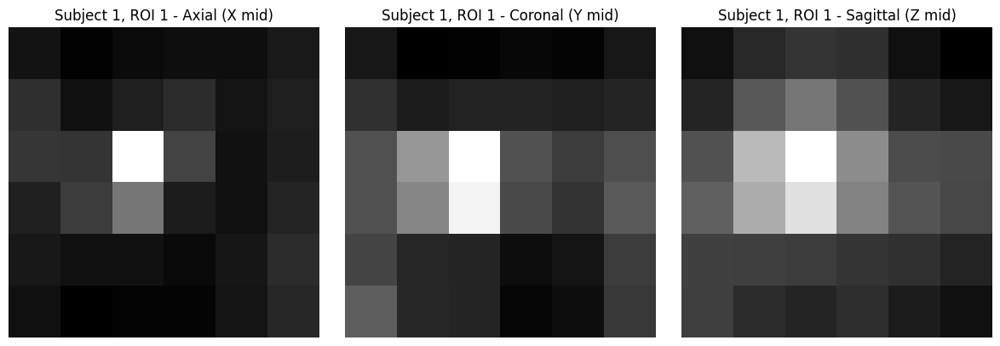

Feature matrix shape: (1, 9)
[[0.83103339 0.17252862 0.83103339 0.16962287 0.83103339 0.13856618
  0.61540232 0.61053357 0.36951306]]


In [ ]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter, gaussian_laplace, zoom

X = []

# ---------------------------
# Upsample and Estimate Sigma
# ---------------------------

def upsample_patch(patch, scale=2):
    return zoom(patch, zoom=scale, order=1)

def estimate_sigma_by_LoG(patch_up, sigma_range=np.arange(0.8, 5.0, 0.2)):
    max_response = -np.inf
    best_sigma = 1.0
    for sigma in sigma_range:
        log_response = gaussian_laplace(patch_up, sigma=sigma)
        response_strength = np.abs(log_response).max()
        if response_strength > max_response:
            max_response = response_strength
            best_sigma = sigma
    return best_sigma

# ---------------------------
# Dynamic ROI extraction
# ---------------------------

def extract_dynamic_rois(swi_data, coordinates, init_patch_size=24, scale=2):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        x_start = max(0, x - init_patch_size // 2)
        x_end = min(swi_data.shape[0], x + (init_patch_size + 1) // 2)
        y_start = max(0, y - init_patch_size // 2)
        y_end = min(swi_data.shape[1], y + (init_patch_size + 1) // 2)
        z_start = max(0, z - init_patch_size // 2)
        z_end = min(swi_data.shape[2], z + (init_patch_size + 1) // 2)

        roi_init = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        roi_up = upsample_patch(roi_init, scale=scale)
        sigma = estimate_sigma_by_LoG(roi_up)

        roi_size = int(round(6 * sigma / scale))
        roi_size = max(roi_size, 6)

        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)

        final_roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(final_roi)
    return rois

# ---------------------------
# Hessian Features
# ---------------------------

def compute_hessian_eigenvalues(roi, sigma=2.5):
    smoothed = gaussian_filter(roi, sigma=sigma)
    Ixx = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(2, 0, 0))
    Iyy = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 2, 0))
    Izz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 0, 2))
    Ixy = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(1, 1, 0))
    Ixz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(1, 0, 1))
    Iyz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 1, 1))

    H = sigma**2 * np.array([
        [Ixx.mean(), Ixy.mean(), Ixz.mean()],
        [Ixy.mean(), Iyy.mean(), Iyz.mean()],
        [Ixz.mean(), Iyz.mean(), Izz.mean()]
    ])
    eigenvalues, eigenvectors = np.linalg.eig(H)
    return eigenvalues, eigenvectors

def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        return 0, 0, 0
    ev = np.sort(np.abs(eigenvalues))
    f_sphere = ev[0] / np.sqrt(ev[1] * ev[2]) if ev[1]*ev[2] != 0 else 0
    f_lc = ev[1] / ev[2] if ev[2] != 0 else 0
    denom = np.sqrt(ev[0]**2 + ev[1]**2 + ev[2]**2)
    num = np.sqrt(0.5 * ((ev[0]-ev[1])**2 + (ev[1]-ev[2])**2 + (ev[0]-ev[2])**2))
    f_fa = num / denom if denom != 0 else 0
    return f_sphere, f_lc, f_fa

# ---------------------------
# Radon-like shape features
# ---------------------------
import matplotlib.pyplot as plt

def visualize_roi(roi, title='ROI'):
    mid_x = roi.shape[0] // 2
    mid_y = roi.shape[1] // 2
    mid_z = roi.shape[2] // 2

    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    axes[0].imshow(roi[mid_x, :, :], cmap='gray')
    axes[0].set_title(f'{title} - Axial (X mid)')
    axes[0].axis('off')

    axes[1].imshow(roi[:, mid_y, :], cmap='gray')
    axes[1].set_title(f'{title} - Coronal (Y mid)')
    axes[1].axis('off')

    axes[2].imshow(roi[:, :, mid_z], cmap='gray')
    axes[2].set_title(f'{title} - Sagittal (Z mid)')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()



def compute_radon_features(rois):
    radon_features = []
    for roi in rois:
        proj_xy = np.sum(roi, axis=2)
        proj_xz = np.sum(roi, axis=1)
        proj_yz = np.sum(roi, axis=0)

        mean_xy = np.mean(proj_xy)
        mean_xz = np.mean(proj_xz)
        mean_yz = np.mean(proj_yz)

        std_xy = np.std(proj_xy)
        std_xz = np.std(proj_xz)
        std_yz = np.std(proj_yz)

        radon_features.append([mean_xy, std_xy, mean_xz, std_xz, mean_yz, std_yz])
    return np.array(radon_features)

# ---------------------------
# Load Excel and Loop Images
# ---------------------------

excel_file = 'sCmb_filteredV5_output-small.xlsx'
df = pd.read_excel(excel_file)
folder_path = 'chunk'

for index, row in df.iterrows():
    nifti_filename = row['NIFTI']
    nifti_path = os.path.join(folder_path, nifti_filename)

    if not os.path.exists(nifti_path):
        continue

    swi_img = nib.load(nifti_path)
    swi_data = swi_img.get_fdata()

    microbleed_coordinates = []
    for i in range(1, len(row), 3):
        try:
            if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                x = int(row.iloc[i])
                y = int(row.iloc[i+1])
                z = int(row.iloc[i+2])
                microbleed_coordinates.append((x, y, z))
        except (ValueError, TypeError, IndexError):
            continue

    # Extract dynamic ROIs
    microbleed_rois = extract_dynamic_rois(swi_data, microbleed_coordinates)

        # VISUALIZE first few ROIs
    for i, roi in enumerate(microbleed_rois[:3]):  # visualize first 3 for example
        title = f'Subject {index+1}, ROI {i+1}'
        visualize_roi(roi, title=title)

    # Compute Radon features
    radon_features_microbleed = compute_radon_features(microbleed_rois)

    # Compute Hessian shape features
    hessian_shape_features_microbleed = []
    for roi in microbleed_rois:
        eigenvals, _ = compute_hessian_eigenvalues(roi)
        hessian_features = compute_hessian_shape_features(eigenvals)
        hessian_shape_features_microbleed.append(np.array(hessian_features))

    # Combine features
    for coord, radon_feat, hessian_feat in zip(microbleed_coordinates, radon_features_microbleed, hessian_shape_features_microbleed):
        combined = np.concatenate((radon_feat, hessian_feat))
        X.append(combined)

# ---------------------------
# Final Output
# ---------------------------

X1 = np.array(X)
print("Feature matrix shape:", X1.shape)
print(X1)

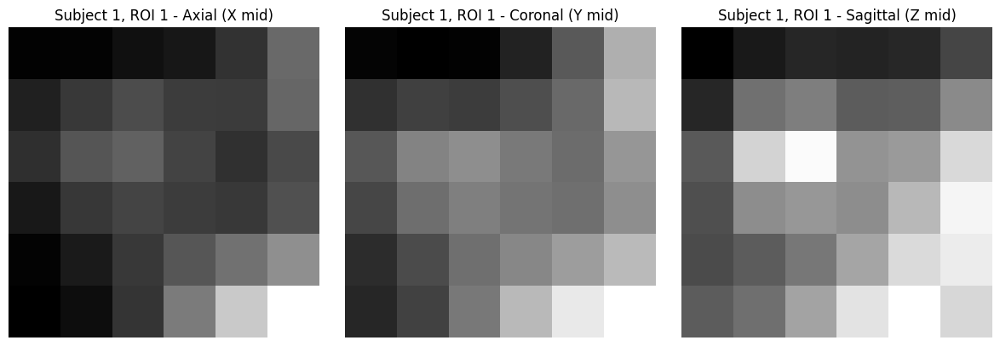

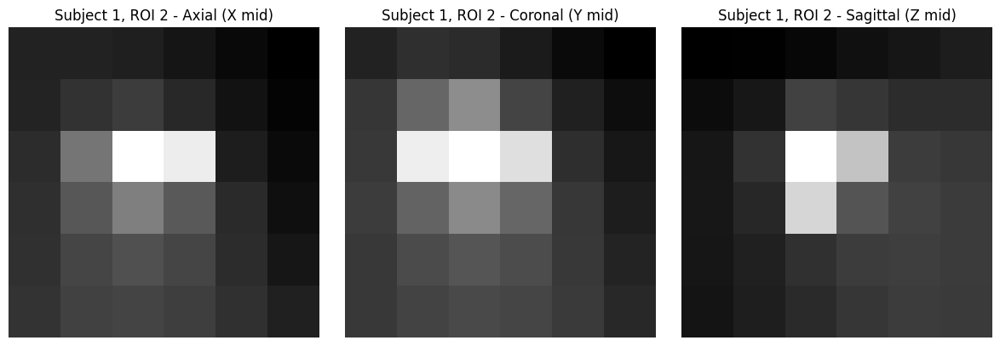

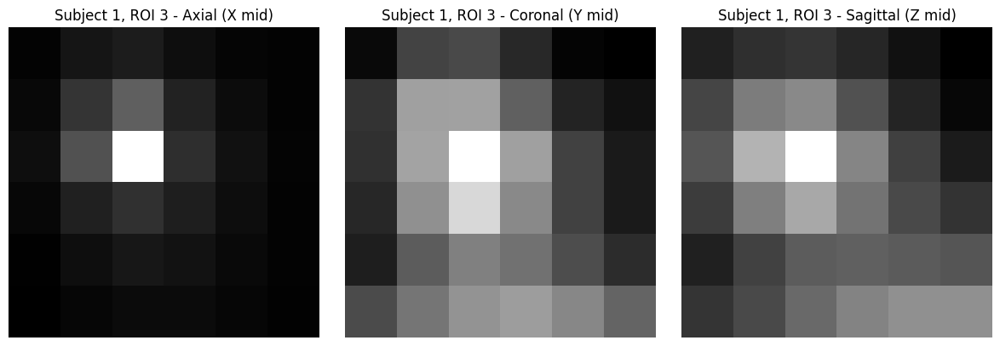

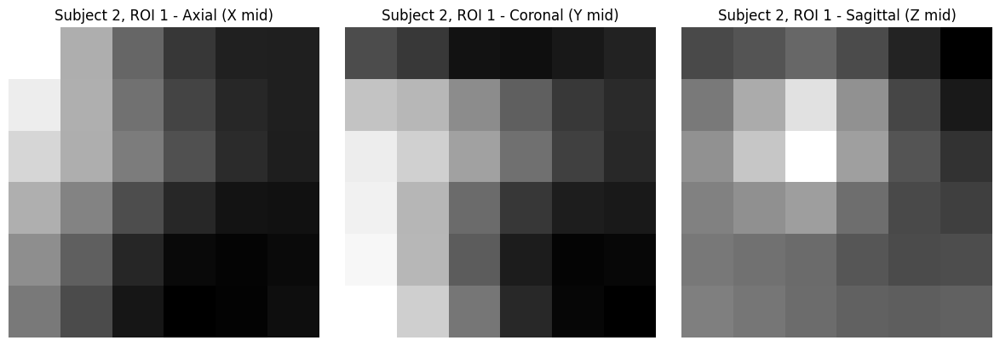

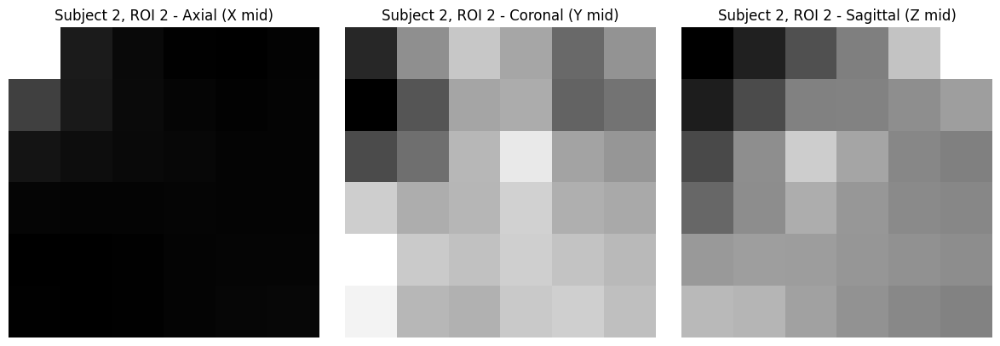

...

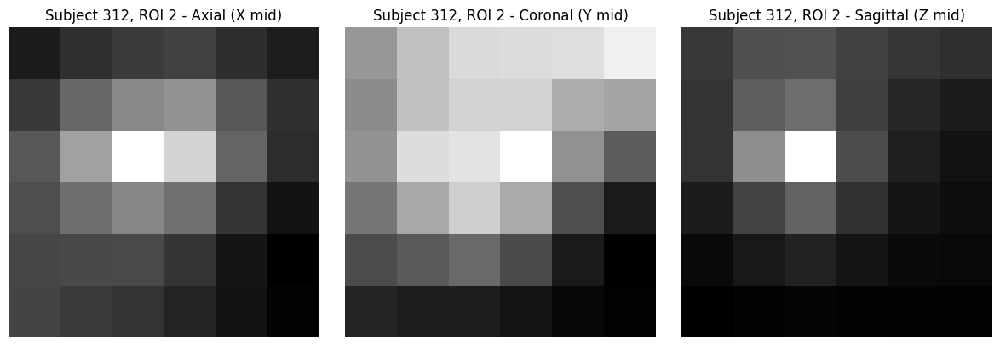

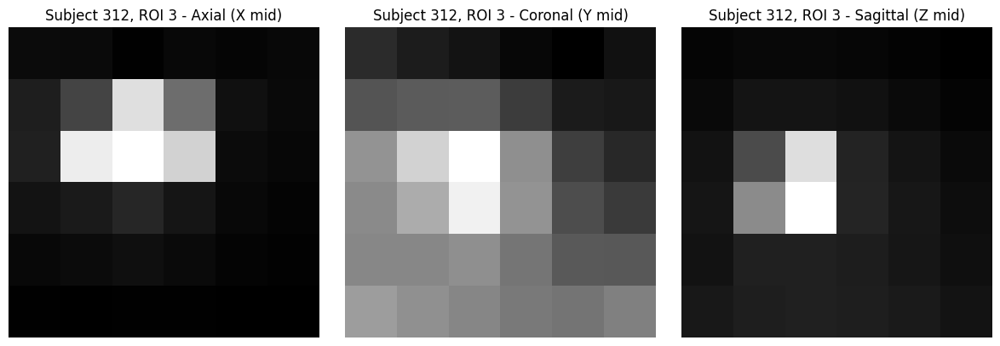

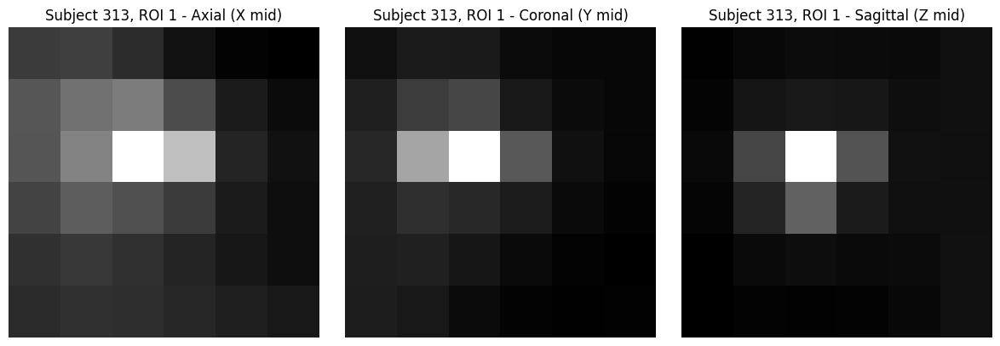

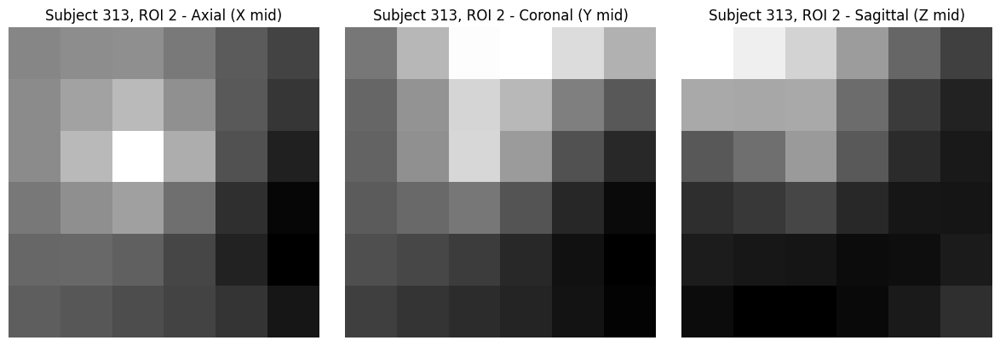

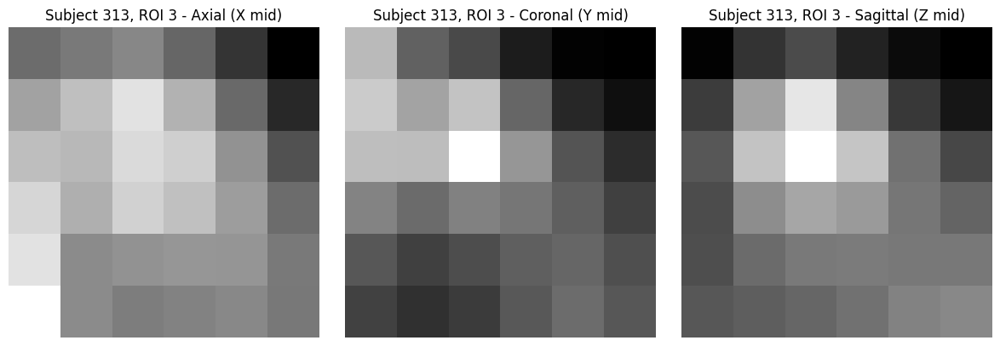

Feature matrix shape: (3130, 9)
[[0.79653015 0.11634758 0.79653015 ... 0.20079805 0.72408129 0.58674668]
 [0.7888038  0.42460107 0.7888038  ... 0.28290741 0.97682203 0.49739114]
 [0.88819691 0.30174193 0.88819691 ... 0.56962715 0.78292335 0.3151671 ]
 ...
 [0.70739309 0.23222287 0.70739309 ... 0.69274824 0.97446846 0.19565332]
 [0.88461617 0.11785202 0.88461617 ... 0.23360353 0.8909683  0.538621  ]
 [0.84059893 0.24339777 0.84059893 ... 0.82549681 0.90656826 0.11897846]]


In [1]:
import pandas as pd
import os
import nibabel as nib
import numpy as np
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter, gaussian_laplace, zoom

X = []

# ---------------------------
# Upsample and Estimate Sigma
# ---------------------------

def upsample_patch(patch, scale=2):
    return zoom(patch, zoom=scale, order=1)

def estimate_sigma_by_LoG(patch_up, sigma_range=np.arange(0.8, 5.0, 0.2)):
    max_response = -np.inf
    best_sigma = 1.0
    for sigma in sigma_range:
        log_response = gaussian_laplace(patch_up, sigma=sigma)
        response_strength = np.abs(log_response).max()
        if response_strength > max_response:
            max_response = response_strength
            best_sigma = sigma
    return best_sigma

# ---------------------------
# Dynamic ROI extraction
# ---------------------------

def extract_dynamic_rois(swi_data, coordinates, init_patch_size=24, scale=2):
    rois = []
    for coord in coordinates:
        x, y, z = coord
        x_start = max(0, x - init_patch_size // 2)
        x_end = min(swi_data.shape[0], x + (init_patch_size + 1) // 2)
        y_start = max(0, y - init_patch_size // 2)
        y_end = min(swi_data.shape[1], y + (init_patch_size + 1) // 2)
        z_start = max(0, z - init_patch_size // 2)
        z_end = min(swi_data.shape[2], z + (init_patch_size + 1) // 2)

        roi_init = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        roi_up = upsample_patch(roi_init, scale=scale)
        sigma = estimate_sigma_by_LoG(roi_up)

        roi_size = int(round(6 * sigma / scale))
        roi_size = max(roi_size, 6)

        x_start = max(0, x - roi_size // 2)
        x_end = min(swi_data.shape[0], x + (roi_size + 1) // 2)
        y_start = max(0, y - roi_size // 2)
        y_end = min(swi_data.shape[1], y + (roi_size + 1) // 2)
        z_start = max(0, z - roi_size // 2)
        z_end = min(swi_data.shape[2], z + (roi_size + 1) // 2)

        final_roi = swi_data[x_start:x_end, y_start:y_end, z_start:z_end]
        rois.append(final_roi)
    return rois

# ---------------------------
# Hessian Features
# ---------------------------

def compute_hessian_eigenvalues(roi, sigma=2.5):
    smoothed = gaussian_filter(roi, sigma=sigma)
    Ixx = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(2, 0, 0))
    Iyy = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 2, 0))
    Izz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 0, 2))
    Ixy = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(1, 1, 0))
    Ixz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(1, 0, 1))
    Iyz = ndimage.gaussian_filter(smoothed, sigma=sigma, order=(0, 1, 1))

    H = sigma**2 * np.array([
        [Ixx.mean(), Ixy.mean(), Ixz.mean()],
        [Ixy.mean(), Iyy.mean(), Iyz.mean()],
        [Ixz.mean(), Iyz.mean(), Izz.mean()]
    ])
    eigenvalues, eigenvectors = np.linalg.eig(H)
    return eigenvalues, eigenvectors

def compute_hessian_shape_features(eigenvalues):
    if len(eigenvalues) != 3:
        return 0, 0, 0
    ev = np.sort(np.abs(eigenvalues))
    f_sphere = ev[0] / np.sqrt(ev[1] * ev[2]) if ev[1]*ev[2] != 0 else 0
    f_lc = ev[1] / ev[2] if ev[2] != 0 else 0
    denom = np.sqrt(ev[0]**2 + ev[1]**2 + ev[2]**2)
    num = np.sqrt(0.5 * ((ev[0]-ev[1])**2 + (ev[1]-ev[2])**2 + (ev[0]-ev[2])**2))
    f_fa = num / denom if denom != 0 else 0
    return f_sphere, f_lc, f_fa

# ---------------------------
# Radon-like shape features
# ---------------------------
import matplotlib.pyplot as plt

def visualize_roi(roi, title='ROI'):
    mid_x = roi.shape[0] // 2
    mid_y = roi.shape[1] // 2
    mid_z = roi.shape[2] // 2

    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    axes[0].imshow(roi[mid_x, :, :], cmap='gray')
    axes[0].set_title(f'{title} - Axial (X mid)')
    axes[0].axis('off')

    axes[1].imshow(roi[:, mid_y, :], cmap='gray')
    axes[1].set_title(f'{title} - Coronal (Y mid)')
    axes[1].axis('off')

    axes[2].imshow(roi[:, :, mid_z], cmap='gray')
    axes[2].set_title(f'{title} - Sagittal (Z mid)')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()



def compute_radon_features(rois):
    radon_features = []
    for roi in rois:
        proj_xy = np.sum(roi, axis=2)
        proj_xz = np.sum(roi, axis=1)
        proj_yz = np.sum(roi, axis=0)

        mean_xy = np.mean(proj_xy)
        mean_xz = np.mean(proj_xz)
        mean_yz = np.mean(proj_yz)

        std_xy = np.std(proj_xy)
        std_xz = np.std(proj_xz)
        std_yz = np.std(proj_yz)

        radon_features.append([mean_xy, std_xy, mean_xz, std_xz, mean_yz, std_yz])
    return np.array(radon_features)

# ---------------------------
# Load Excel and Loop Images
# ---------------------------

excel_file = 'scmb_filteredV6_output.xlsx'
df = pd.read_excel(excel_file)
folder_path = 'Scmb-non'

for index, row in df.iterrows():
    nifti_filename = row['NIFTI']
    nifti_path = os.path.join(folder_path, nifti_filename)

    if not os.path.exists(nifti_path):
        continue

    swi_img = nib.load(nifti_path)
    swi_data = swi_img.get_fdata()

    microbleed_coordinates = []
    for i in range(1, len(row), 3):
        try:
            if pd.notnull(row.iloc[i]) and pd.notnull(row.iloc[i+1]) and pd.notnull(row.iloc[i+2]):
                x = int(row.iloc[i])
                y = int(row.iloc[i+1])
                z = int(row.iloc[i+2])
                microbleed_coordinates.append((x, y, z))
        except (ValueError, TypeError, IndexError):
            continue

    # Extract dynamic ROIs
    microbleed_rois = extract_dynamic_rois(swi_data, microbleed_coordinates)

        # VISUALIZE first few ROIs
    for i, roi in enumerate(microbleed_rois[:3]):  # visualize first 3 for example
        title = f'Subject {index+1}, ROI {i+1}'
        visualize_roi(roi, title=title)

    # Compute Radon features
    radon_features_microbleed = compute_radon_features(microbleed_rois)

    # Compute Hessian shape features
    hessian_shape_features_microbleed = []
    for roi in microbleed_rois:
        eigenvals, _ = compute_hessian_eigenvalues(roi)
        hessian_features = compute_hessian_shape_features(eigenvals)
        hessian_shape_features_microbleed.append(np.array(hessian_features))

    # Combine features
    for coord, radon_feat, hessian_feat in zip(microbleed_coordinates, radon_features_microbleed, hessian_shape_features_microbleed):
        combined = np.concatenate((radon_feat, hessian_feat))
        X.append(combined)

# ---------------------------
# Final Output
# ---------------------------

X1 = np.array(X)
print("Feature matrix shape:", X1.shape)
print(X1)